<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
<div align="center">
    <h1>NYC TLC Trip Records</h1>
</div>

### Latar Belakang NYC TLC:

New York City Taxi and Limousine Commission (TLC) merupakan badan yang bertanggung jawab atas regulasi dan perizinan taksi medali (yellow taxi), street hail livery (green taxi), kendaraan sewaan (for-hire vehicles/FHVs), van komuter, dan kendaraan paratransit di New York City. Didirikan pada tahun 1971 berdasarkan Undang-Undang Daerah No. 12, TLC memiliki peran sentral dalam pengembangan dan peningkatan layanan taksi serta sewa di Kota New York.

TLC tidak hanya berwenang dalam mengatur perizinan, tetapi juga menetapkan tarif, standar layanan, persyaratan asuransi, keselamatan driver, desain kendaraan, serta kriteria perizinan bagi kendaraan, driver, dan operator/vendor yang beroperasi dalam layanan transportasi ini. Lembaga ini juga memastikan agar layanan taksi dan kendaraan sewa berfungsi selaras dengan jaringan transportasi publik di kota.

### Stakeholder:

TLC sebagai pengelola utama industri taksi di New York City memiliki tanggung jawab untuk memastikan efisiensi layanan dan kepuasan para pengemudi. Dalam upaya memajukan sektor ini, TLC bertujuan untuk mengidentifikasi area dan waktu penjemputan yang paling ramai, baik pada hari kerja maupun akhir pekan. Informasi ini penting bagi TLC untuk mengoptimalkan distribusi armada taksi, sehingga pengemudi dapat memaksimalkan pendapatan mereka. Dengan pemahaman yang lebih baik tentang pola penjemputan, TLC dapat memberikan arahan yang lebih tepat kepada vendor untuk mendukung pengemudi dalam mengelola rute dan jadwal mereka. Tujuan akhirnya adalah untuk memastikan para pengemudi tetap mendapatkan penghasilan yang memadai sambil menjaga kelancaran operasional industri taksi di kota New York.

Sebagai langkah strategis, TLC berencana untuk mengidentifikasi berbagai aspek penting terkait pola waktu dan wilayah penjemputan yang padat, serta mengkaji korelasi antara waktu, lokasi, dan pendapatan yang diperoleh driver pada bulan Januari 2023.

### Rumusan Masalah:

**Analisis Berdasarkan Waktu Penjemputan:**
1. **Kapan waktu (jam) penjemputan paling ramai?** Membandingkan jam-jam puncak penjemputan antara weekend dan weekday.
2. **Bagaimana distribusi total pendapatan berdasarkan waktu?** Mengkaji perbedaan distribusi pendapatan pada jam-jam tertentu di weekend dan weekday.

**Analisis Berdasarkan Wilayah Penjemputan:**
1. **Wilayah mana yang paling sibuk?** Menentukan zona dan borough dengan aktivitas penjemputan tertinggi pada weekend dan weekday.
2. **Kapan waktu (jam) penjemputan paling ramai di setiap borough?** Mengidentifikasi jam puncak penjemputan di tiap borough pada weekend dan weekday.

Melalui analisis mendalam terhadap semua faktor ini, TLC diharapkan dapat mengembangkan strategi yang efektif untuk meningkatkan kualitas layanan, mendukung peningkatan pendapatan driver, serta memberikan dampak positif bagi pengelolaan transportasi di New York City.

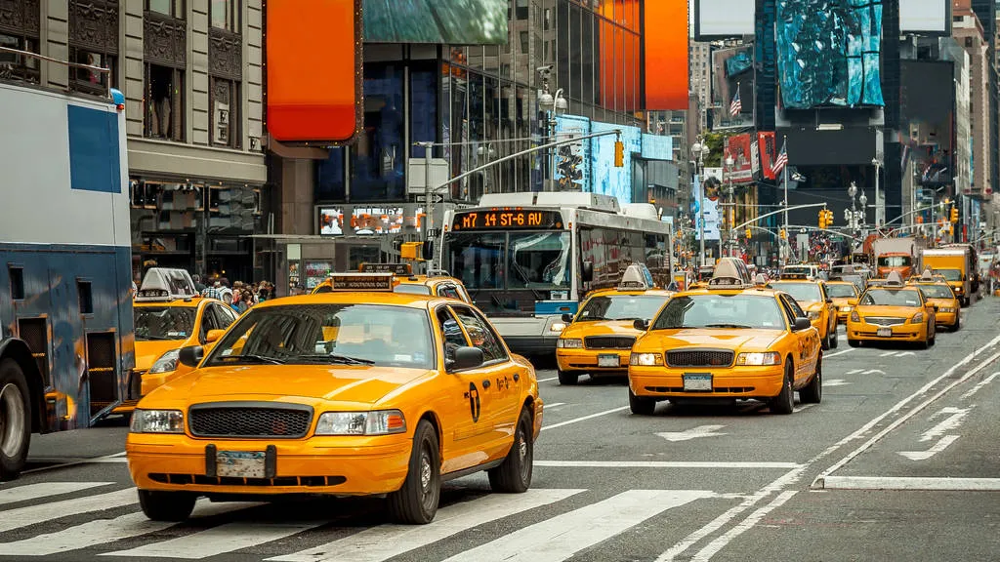
<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Sumber : <a href="https://www.nyc.gov/site/tlc/about/about-tlc.page" target="_blank">NYC TLC</a>

In [1]:
# import library yang dibutuhkan
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import datetime as dt
import missingno as msno
import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 400)

import matplotlib.pyplot as plt
import missingno as msno
from matplotlib import font_manager

from matplotlib import rcParams
rcParams['font.family'] = 'Poppins' 

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>

# **Load NYC TLC Trip Record Dataset**

In [2]:
df = pd.read_csv('NYC_TLC_Trip_Record.csv')

display(df.head(), df.tail(), df.sample(5))

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge
0,2,2023-01-01 00:26:10,2023-01-01 00:37:11,N,1.0,166,143,1.0,2.58,14.9,1.0,0.5,4.03,0.0,NaN,1.0,24.18,1.0,1.0,2.75
1,2,2023-01-01 00:51:03,2023-01-01 00:57:49,N,1.0,24,43,1.0,1.81,10.7,1.0,0.5,2.64,0.0,NaN,1.0,15.84,1.0,1.0,0.00
2,2,2023-01-01 00:35:12,2023-01-01 00:41:32,N,1.0,223,179,1.0,0.00,7.2,1.0,0.5,1.94,0.0,NaN,1.0,11.64,1.0,1.0,0.00
3,1,2023-01-01 00:13:14,2023-01-01 00:19:03,N,1.0,41,238,1.0,1.30,6.5,0.5,1.5,1.70,0.0,NaN,1.0,10.20,1.0,1.0,0.00
4,1,2023-01-01 00:33:04,2023-01-01 00:39:02,N,1.0,41,74,1.0,1.10,6.0,0.5,1.5,0.00,0.0,NaN,1.0,8.00,1.0,1.0,0.00


,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge
68206,2,2023-01-31 22:29:00,2023-01-31 22:42:00,NaN,NaN,49,62,NaN,4070.82,15.70,0.0,0.0,0.00,0.0,NaN,1.0,16.70,NaN,NaN,NaN
68207,2,2023-01-31 22:40:00,2023-01-31 22:48:00,NaN,NaN,10,205,NaN,2.14,4.41,0.0,0.0,0.00,0.0,NaN,1.0,5.41,NaN,NaN,NaN
68208,2,2023-01-31 23:46:00,2023-02-01 00:02:00,NaN,NaN,66,37,NaN,3.44,16.53,0.0,0.0,3.51,0.0,NaN,1.0,21.04,NaN,NaN,NaN
68209,2,2023-01-31 23:01:00,2023-01-31 23:19:00,NaN,NaN,225,189,NaN,3.03,14.98,0.0,0.0,3.20,0.0,NaN,1.0,19.18,NaN,NaN,NaN
68210,2,2023-01-31 23:51:00,2023-02-01 00:07:00,NaN,NaN,256,140,NaN,5.82,23.65,0.0,0.0,2.00,0.0,NaN,1.0,29.40,NaN,NaN,NaN


,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge
25751,2,2023-01-13 17:13:31,2023-01-13 17:28:43,N,1.0,166,75,1.0,1.69,14.9,2.5,0.5,0.00,0.0,NaN,1.0,18.90,1.0,1.0,0.00
31167,2,2023-01-16 17:09:10,2023-01-16 17:17:47,N,1.0,95,134,1.0,1.13,10.0,0.0,0.5,0.00,0.0,NaN,1.0,11.50,2.0,1.0,0.00
35075,2,2023-01-18 16:37:41,2023-01-18 16:46:52,N,1.0,43,74,1.0,1.63,11.4,2.5,0.5,3.08,0.0,NaN,1.0,18.48,1.0,1.0,0.00
19748,2,2023-01-11 08:10:01,2023-01-11 08:13:49,N,1.0,75,75,1.0,0.49,5.8,0.0,0.5,1.32,0.0,NaN,0.3,7.92,1.0,1.0,0.00
54284,2,2023-01-27 09:35:13,2023-01-27 10:02:07,N,1.0,166,4,2.0,7.94,37.3,0.0,0.5,8.31,0.0,NaN,1.0,49.86,1.0,1.0,2.75


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
# 1. **Data Understanding**
<!DOCTYPE html>
<html lang="en">
<head>
    <meta charset="UTF-8">
    <meta name="viewport" content="width=device-width, initial-scale=1.0">
    <title>NYC TLC Trip Record Column Descriptions</title>
    <style>
        body {
            font-family: Arial, sans-serif;
            margin: 20px;
            padding: 20px;
            background-color: #f4f4f4;
        }
        table {
            width: 100%;
            border-collapse: collapse;
            margin-bottom: 20px;
        }
        table, th, td {
            border: 1px solid #ccc;
        }
        th, td {
            padding: 10px;
            text-align: left;
        }
        th {
            background-color: #f8f8f8;
        }
        tr:nth-child(even) {
            background-color: #f9f9f9;
        }
    </style>
</head>
<body>
    <h1>NYC TLC Trip Record Column Descriptions</h1>
    <table>
        <thead>
            <tr>
                <th>Column</th>
                <th>Description</th>
            </tr>
        </thead>
        <tbody>
            <tr>
                <td><strong>VendorID</strong></td>
                <td>ID vendor yang mengoperasikan taksi. Ada dua vendor utama di NYC: 
                1 = Creative Mobile Technologies, LLC., 
                2 = VeriFone Inc.</td>
            </tr>
            <tr>
                <td><strong>lpep_pickup_datetime</strong></td>
                <td>Format datetime yang mencatat kapan penumpang mulai naik taksi.</td>
            </tr>
            <tr>
                <td><strong>lpep_dropoff_datetime</strong></td>
                <td>Format datetime yang mencatat kapan penumpang turun dari taksi.</td>
            </tr>
            <tr>
                <td><strong>Store_and_fwd_flag</strong></td>
                <td>Menunjukkan apakah data perjalanan disimpan di memori kendaraan sebelum dikirimkan ke server (Y = Yes, N = No).</td>
            </tr>
            <tr>
                <td><strong>RatecodeID</strong></td>
                <td>Kode tarif yang digunakan untuk perjalanan: 
                1 = Standard rate, 
                2 = JFK, 
                3 = Newark, 
                4 = Nassau or Westchester, 
                5 = Negotiated fare, 
                6 = Group ride.</td>
            </tr>
            <tr>
                <td><strong>PULocationID</strong></td>
                <td>ID lokasi penjemputan. Merujuk pada zona atau area tertentu di NYC.</td>
            </tr>
            <tr>
                <td><strong>DOLocationID</strong></td>
                <td>ID lokasi penurunan. Merujuk pada zona atau area tertentu di NYC.</td>
            </tr>
            <tr>
                <td><strong>Passenger_count</strong></td>
                <td>Jumlah penumpang dalam satu perjalanan. Berkisar dari 1 hingga lebih, tergantung kapasitas taksi.</td>
            </tr>
            <tr>
                <td><strong>Trip_distance</strong></td>
                <td>Jarak yang ditempuh dalam perjalanan (mil).</td>
            </tr>
            <tr>
                <td><strong>Fare_amount</strong></td>
                <td>Jumlah tarif yang dibebankan untuk perjalanan. Tidak termasuk biaya tambahan seperti tol dan tip.</td>
            </tr>
            <tr>
                <td><strong>Extra</strong></td>
                <td>Biaya tambahan seperti biaya malam hari atau biaya perjalanan di jam sibuk.</td>
            </tr>
            <tr>
                <td><strong>MTA_tax</strong></td>
                <td>Pajak tambahan sebesar $0.50 yang diterapkan pada setiap perjalanan taksi di NYC.</td>
            </tr>
            <tr>
                <td><strong>Tip_amount</strong></td>
                <td>Jumlah tip yang diberikan oleh penumpang (jika menggunakan pembayaran non-tunai).</td>
            </tr>
            <tr>
                <td><strong>Tolls_amount</strong></td>
                <td>Jumlah biaya tol yang dikenakan selama perjalanan.</td>
            </tr>
            <tr>
                <td><strong>Ehail_fee</strong></td>
                <td>Biaya tambahan untuk pemesanan elektronik. Kolom ini sering kosong jika tidak ada biaya yang diterapkan.</td>
            </tr>
            <tr>
                <td><strong>Improvement_surcharge</strong></td>
                <td>Biaya tambahan sebesar $0.30 untuk setiap perjalanan taksi di NYC.</td>
            </tr>
            <tr>
                <td><strong>Total_amount</strong></td>
                <td>Jumlah total yang dibebankan kepada penumpang. Termasuk tarif dasar, biaya tambahan, pajak, tip, dan biaya tol.</td>
            </tr>
            <tr>
                <td><strong>Payment_type</strong></td>
                <td>Jenis pembayaran yang digunakan oleh penumpang: 
                1 = Credit card, 
                2 = Cash, 
                3 = No charge, 
                4 = Dispute, 
                5 = Unknown, 
                6 = Voided trip.</td>
            </tr>
            <tr>
                <td><strong>Trip_type</strong></td>
                <td>Jenis perjalanan yang dilakukan: 1 = Street-hail, 2 = Dispatch.</td>
            </tr>
            <tr>
                <td><strong>Congestion_surcharge</strong></td>
                <td>Biaya tambahan yang diterapkan untuk perjalanan di area kemacetan, biasanya sebesar $2.50.</td>
            </tr>
        </tbody>
    </table>
</body>
</html>

In [3]:
display(df.info(), df.sample(5))

print(f'This dataset has {df.shape[0]} rows and {df.shape[1]} columns')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 68211 entries, 0 to 68210
Data columns (total 20 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   VendorID               68211 non-null  int64  
 1   lpep_pickup_datetime   68211 non-null  object 
 2   lpep_dropoff_datetime  68211 non-null  object 
 3   store_and_fwd_flag     63887 non-null  object 
 4   RatecodeID             63887 non-null  float64
 5   PULocationID           68211 non-null  int64  
 6   DOLocationID           68211 non-null  int64  
 7   passenger_count        63887 non-null  float64
 8   trip_distance          68211 non-null  float64
 9   fare_amount            68211 non-null  float64
 10  extra                  68211 non-null  float64
 11  mta_tax                68211 non-null  float64
 12  tip_amount             68211 non-null  float64
 13  tolls_amount           68211 non-null  float64
 14  ehail_fee              0 non-null      float64
 15  im

None

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge
64630,2,2023-01-06 09:53:00,2023-01-06 10:16:00,NaN,NaN,130,82,NaN,7.86,37.25,0.0,0.0,3.28,0.0,NaN,1.0,41.53,NaN,NaN,NaN
18161,2,2023-01-10 13:20:39,2023-01-10 13:28:27,N,1.0,152,239,3.0,3.41,15.60,0.0,0.5,3.83,0.0,NaN,0.3,22.98,1.0,1.0,2.75
2724,2,2023-01-02 23:12:17,2023-01-02 23:16:22,N,1.0,134,197,1.0,1.27,7.90,1.0,0.5,2.60,0.0,NaN,1.0,13.00,1.0,1.0,0.00
7010,2,2023-01-05 00:32:12,2023-01-05 00:34:43,N,1.0,7,7,1.0,0.73,5.10,1.0,0.5,0.00,0.0,NaN,1.0,7.60,2.0,1.0,0.00
8941,2,2023-01-05 19:46:11,2023-01-05 19:52:26,N,1.0,82,129,1.0,0.61,7.20,2.5,0.5,2.02,0.0,NaN,1.0,13.22,1.0,1.0,0.00


This dataset has 68211 rows and 20 columns


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Dari pengecekan yang telah dilakukan, dataset ini memiliki 68.211 baris dan 20 kolom. Ditemukan beberapa kolom dengan tipe data yang belum tepat. Selanjutnya, tipe data pada kolom-kolom tersebut akan diperbaiki agar sesuai dengan tipe data seharusnya dan memudahkan proses analisis nantinya.

In [4]:
# Menyesuaikan tipe data pada kolom VendorID, store_and_fwd_flag, dan RatecodeID, PULocationID, DOLocationID dengan tipe category
df['VendorID'] = df['VendorID'].astype('category')
df['store_and_fwd_flag'] = df['store_and_fwd_flag'].astype('category')
df['RatecodeID'] = df['RatecodeID'].astype('category')
df['DOLocationID'] = df['DOLocationID'].astype('category')
df['PULocationID'] = df['PULocationID'].astype('category')

# Menyesuaikan tipe data pada kolom lpep_pickup_datetime, lpep_dropoff_datetime dengan tipe datetime
df['lpep_pickup_datetime'] = pd.to_datetime(df['lpep_pickup_datetime'])
df['lpep_dropoff_datetime'] = pd.to_datetime(df['lpep_dropoff_datetime'])

# Menyesuaikan tipe data pada payment_type dan trip_type dengan tipe category
df['payment_type'] = df['payment_type'].astype('category')
df['trip_type'] = df['trip_type'].astype('category')

In [5]:
# tampilkan deskriptif statistik numeric
display(df.describe(include='number'), df.describe(include=['object', 'category']), df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 68211 entries, 0 to 68210
Data columns (total 20 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   VendorID               68211 non-null  category      
 1   lpep_pickup_datetime   68211 non-null  datetime64[ns]
 2   lpep_dropoff_datetime  68211 non-null  datetime64[ns]
 3   store_and_fwd_flag     63887 non-null  category      
 4   RatecodeID             63887 non-null  category      
 5   PULocationID           68211 non-null  category      
 6   DOLocationID           68211 non-null  category      
 7   passenger_count        63887 non-null  float64       
 8   trip_distance          68211 non-null  float64       
 9   fare_amount            68211 non-null  float64       
 10  extra                  68211 non-null  float64       
 11  mta_tax                68211 non-null  float64       
 12  tip_amount             68211 non-null  float64       
 13  t

,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,congestion_surcharge
count,63887.000000,68211.000000,68211.000000,68211.000000,68211.000000,68211.000000,68211.000000,0.0,68211.000000,68211.000000,63887.000000
mean,1.315870,8.114852,16.603545,0.825431,0.588340,2.139012,0.169627,NaN,0.951625,21.789377,0.726748
std,0.979054,585.105955,13.470121,1.269904,0.385819,3.052710,1.099789,NaN,0.196875,15.457115,1.212836
min,0.000000,0.000000,-70.000000,-2.500000,-0.500000,-10.500000,0.000000,NaN,-1.000000,-71.500000,-2.750000
25%,1.000000,1.110000,9.300000,0.000000,0.500000,0.000000,0.000000,NaN,1.000000,12.900000,0.000000
50%,1.000000,1.850000,13.500000,0.000000,0.500000,1.600000,0.000000,NaN,1.000000,17.900000,0.000000
75%,1.000000,3.210000,19.800000,1.000000,0.500000,3.330000,0.000000,NaN,1.000000,26.150000,2.750000
max,9.000000,120098.840000,490.000000,12.500000,2.750000,222.220000,36.050000,NaN,1.000000,491.000000,2.750000


,VendorID,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,payment_type,trip_type
count,68211,63887,63887.0,68211,68211,63887.0,63877.0
unique,2,2,6.0,226,249,5.0,2.0
top,2,N,1.0,74,75,1.0,1.0
freq,58868,63579,62103.0,13257,3524,40686.0,62476.0


None

In [6]:
# unique val untuk kolom categorical exclue PU DO
columns_of_interest = ['VendorID', 'store_and_fwd_flag', 'RatecodeID', 'payment_type', 'trip_type']

listItem = []
for col in columns_of_interest:
    listItem.append([col, df[col].nunique(), df[col].unique()])

unique_col = pd.DataFrame(listItem, columns=['Column Name', 'Number of Unique', 'Unique Value'])

unique_col

,Column Name,Number of Unique,Unique Value
0,VendorID,2,"[2, 1] Categories (2, int64): [1, 2]"
1,store_and_fwd_flag,2,"['N', 'Y', NaN] Categories (2, object): ['N', ..."
2,RatecodeID,6,"[1.0, 5.0, 4.0, 3.0, 2.0, 99.0, NaN] Categorie..."
3,payment_type,5,"[1.0, 2.0, 3.0, 4.0, 5.0, NaN] Categories (5, ..."
4,trip_type,2,"[1.0, 2.0, NaN] Categories (2, float64): [1.0,..."


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>

Selama eksplorasi data awal, ditemukan beberapa anomali, missing value, dan nilai yang tidak masuk akal:

- **Negative Value:** Beberapa kolom mengandung value negatif yang tidak diharapkan berdasarkan konteks data. Setelah diteliti lebih lanjut, value negatif ini kemungkinan besar disebabkan oleh kesalahan input dan seharusnya bervalue positif.

- **Missing Value:** Terdapat juga beberapa missing value dalam dataset, yang perlu ditangani pada proses pembersihan data agar analisis dapat dilakukan dengan lebih akurat.

- **Anomaly dan Nilai Tidak Masuk Akal:** Beberapa kolom seperti `fare_amount`, `tip_amount`, `improvement_surcharge`, dan `total_amount` memiliki nilai yang tidak masuk akal (contohnya nilai negatif atau nilai yang sangat ekstrem seperti jarak perjalanan 120,098.84 mil). Anomali ini menunjukkan adanya kemungkinan kesalahan pencatatan data yang perlu diperbaiki.

Masalah ini akan diperbaiki pada tahap pembersihan data sebelum melanjutkan ke analisis lebih lanjut.

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>

# **2. Missing Value, Duplicate data, and Anomaly**

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
### Cek missing value dan duplicate

<Figure size 800x600 with 0 Axes>

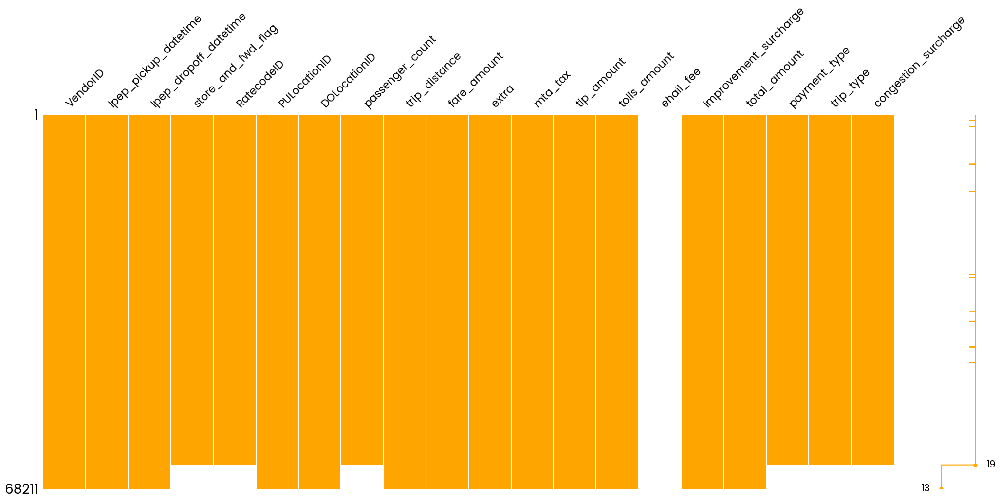

In [7]:
plt.figure(figsize=(8, 6))  # Ukuran gambar
msno.matrix(df, sparkline=True, color=(1.0, 0.65, 0.0))  # garis sparkline
plt.show()


In [8]:
duplicates_count = df.duplicated().sum()

# Persentase missing value per kolom
missing_percentage = (df.isna().mean().round(4) * 100).astype(str) + '%'

# Jumlah total missing value per kolom
total_missing = df.isna().sum()

# Menggabungkan semua informasi missing value
info_df = pd.DataFrame({
    'Column': df.columns,
    'Missing Percentage (%)': missing_percentage,
    'Total Missing Values': total_missing
}).reset_index(drop=True)

display(info_df)
print(f'This dataset has {duplicates_count} duplicates')

,Column,Missing Percentage (%),Total Missing Values
0,VendorID,0.0%,0
1,lpep_pickup_datetime,0.0%,0
2,lpep_dropoff_datetime,0.0%,0
3,store_and_fwd_flag,6.34%,4324
4,RatecodeID,6.34%,4324
5,PULocationID,0.0%,0
6,DOLocationID,0.0%,0
7,passenger_count,6.34%,4324
8,trip_distance,0.0%,0
9,fare_amount,0.0%,0


This dataset has 0 duplicates


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>

Dari hasil analisis missing values, dapat disimpulkan bahwa dataset ini memiliki beberapa kolom yang mengandung missing values dengan tingkat yang bervariasi. Beberapa poin penting yang perlu diperhatikan adalah:

1. **Kolom dengan Missing Values Tertinggi:**
   - Kolom `ehail_fee` memiliki 100% missing values (semua data hilang). Ini mungkin disebabkan oleh kolom ini yang tidak relevan dalam konteks penggunaan dataset ini atau data yang tidak pernah terisi. Data set ini akan dirop karena sudah tidak relevan untuk dianalisa lebih lanjut
   
2. **Kolom dengan Missing Values (6.34%-6.35%):**
   - Kolom seperti `store_and_fwd_flag`, `RatecodeID`, `passenger_count`, `payment_type`, `trip_type`, dan `congestion_surcharge` memiliki missing values 6.34%, missing value ini akan saya drop karena tidak dapat diisi salah satu dan apabila dilakukan pengisian data akan kurang merepresentasikan data missing tersebut.

3. **Kolom Lain:**
   - Kolom lain seperti `PULocationID`, `DOLocationID`, `trip_distance`, `fare_amount`, dan beberapa lainnya tidak memiliki missing values sama sekali.

4. **Tidak Ada Data Duplikat:**
   - Berdasarkan hasil analisis, dataset ini tidak memiliki data duplikat, sehingga tidak perlu melakukan proses penghapusan data duplikat.

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
## 2. 1 Handle Missing Value

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
### `ehail_fee`
Kolom ini memiliki 100% missing value yang kemungkinan karena layanan taksi dalam data ini tidak menggunakan pemesanan elektronik, menjadikannya tidak relevan untuk analisis. Kolom ini akan dihapus

In [9]:
df.drop('ehail_fee', axis=1, inplace=True)

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Membuat kolom validasi untuk perhitungan dari kolom `total_amount` 

In [10]:
df["total_amount_validation"] = round(df['fare_amount'] + df["extra"] + df["mta_tax"] + df["tip_amount"] + df["tolls_amount"]+ df["improvement_surcharge"] + df["congestion_surcharge"],2)
df.sample(5)

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge,total_amount_validation
64460,2,2023-01-05 09:34:00,2023-01-05 10:04:00,NaN,NaN,188,67,NaN,4.27,25.35,0.0,0.0,5.27,0.0,1.0,31.62,NaN,NaN,NaN,NaN
51701,2,2023-01-26 08:35:33,2023-01-26 08:49:23,N,1.0,74,75,1.0,0.94,12.80,0.0,0.5,2.86,0.0,1.0,17.16,1.0,1.0,0.0,17.16
22841,1,2023-01-12 14:52:43,2023-01-12 14:58:08,N,1.0,74,75,1.0,1.10,7.20,0.0,1.5,0.00,0.0,1.0,8.70,2.0,1.0,0.0,9.70
53397,2,2023-01-26 19:02:04,2023-01-27 18:20:20,N,1.0,95,223,1.0,7.42,35.20,2.5,0.5,0.00,0.0,1.0,39.20,2.0,1.0,0.0,39.20
6250,2,2023-01-04 17:55:36,2023-01-04 18:01:13,N,1.0,75,74,1.0,1.46,8.60,2.5,0.5,2.52,0.0,1.0,15.12,1.0,1.0,0.0,15.12


In [11]:
# drop seluruh baris yang mengandung missing value
df.dropna(inplace=True)

In [12]:
df.isna().sum()

VendorID                   0
lpep_pickup_datetime       0
lpep_dropoff_datetime      0
store_and_fwd_flag         0
RatecodeID                 0
PULocationID               0
DOLocationID               0
passenger_count            0
trip_distance              0
fare_amount                0
extra                      0
mta_tax                    0
tip_amount                 0
tolls_amount               0
improvement_surcharge      0
total_amount               0
payment_type               0
trip_type                  0
congestion_surcharge       0
total_amount_validation    0
dtype: int64

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
## 2. 2 Handle Negative Value

Mengatasi negative value dengan drop value dari kolom seperti total_amount karena negative value pada kolom tersebut tidak masuk akal

In [13]:
df.describe(include='number')

,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,total_amount_validation
count,63877.000000,63877.000000,63877.000000,63877.000000,63877.000000,63877.000000,63877.000000,63877.000000,63877.000000,63877.000000,63877.000000
mean,1.315920,2.576974,16.074491,0.880473,0.626951,2.041507,0.144182,0.949187,21.200955,0.726862,21.443654
std,0.979123,6.760261,13.277144,1.292861,0.366919,2.998734,1.012740,0.201782,15.131310,1.212897,15.180883
min,0.000000,0.000000,-70.000000,-2.500000,-0.500000,-10.500000,0.000000,-1.000000,-71.500000,-2.750000,-71.500000
25%,1.000000,1.100000,9.000000,0.000000,0.500000,0.000000,0.000000,1.000000,12.600000,0.000000,12.850000
50%,1.000000,1.800000,12.800000,0.000000,0.500000,1.400000,0.000000,1.000000,17.500000,0.000000,17.700000
75%,1.000000,3.050000,19.100000,1.000000,0.500000,3.220000,0.000000,1.000000,25.500000,2.750000,25.860000
max,9.000000,1571.970000,490.000000,12.500000,2.750000,222.220000,36.050000,1.000000,491.000000,2.750000,491.000000


In [14]:
# mengambil semua baris yang tidak bernilai negatif
df = df[(df[['fare_amount', 'extra', 'mta_tax', 'tip_amount', 'tolls_amount', 'improvement_surcharge', 'congestion_surcharge']] >= 0).all(axis=1)]

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
## 2. 3 Handle Data Anomali

#### `fare_amount` value kurang dari 3
Minimum fare dari Taksi NYC TLC yaitu 3 dollar. 

Sumber : <a href="https://www.nyc.gov/site/tlc/passengers/taxi-fare.page" target="_blank">NYC TLC Trip Record Data Fare</a>

In [15]:
df.drop(df[df['fare_amount'] <= 3].index, inplace=True)

#### `total_amount` value kurang dari 3

In [16]:
df.drop(df[df['total_amount'] <= 3].index, inplace=True)

#### `trip_distance` 0 value

In [17]:
# cek presentase kolom trip_distance yang bernilai 0
pct_zero = df[df['trip_distance'] == 0].shape[0] / df.shape[0]
print(f'{pct_zero:.2%} of rows have 0 trip_distance')

4.07% of rows have 0 trip_distance


In [18]:
# cek data trip_distance yang bernilai kurang dari sama dengan 0
df[df['trip_distance'] <= 0]

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge,total_amount_validation
2,2,2023-01-01 00:35:12,2023-01-01 00:41:32,N,1.0,223,179,1.0,0.0,7.2,1.0,0.5,1.94,0.0,1.0,11.64,1.0,1.0,0.0,11.64
58,2,2023-01-01 00:57:15,2023-01-01 01:00:15,N,1.0,75,75,1.0,0.0,4.4,1.0,0.5,1.38,0.0,1.0,8.28,1.0,1.0,0.0,8.28
99,2,2023-01-01 01:27:36,2023-01-01 01:27:43,N,5.0,168,168,0.0,0.0,20.0,0.0,0.0,0.00,0.0,1.0,21.00,1.0,2.0,0.0,21.00
166,2,2023-01-01 02:37:12,2023-01-01 02:37:15,N,5.0,51,264,3.0,0.0,40.0,0.0,0.0,0.00,0.0,1.0,41.00,1.0,2.0,0.0,41.00
173,2,2023-01-01 02:37:12,2023-01-01 02:37:15,N,5.0,260,264,1.0,0.0,20.0,0.0,0.0,4.20,0.0,1.0,25.20,1.0,2.0,0.0,25.20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63756,2,2023-01-31 21:56:14,2023-01-31 21:56:16,N,5.0,97,264,1.0,0.0,12.0,0.0,0.0,0.00,0.0,1.0,13.00,1.0,2.0,0.0,13.00
63798,2,2023-01-31 22:19:41,2023-01-31 22:27:59,N,1.0,42,152,1.0,0.0,8.6,1.0,0.5,0.00,0.0,1.0,11.10,2.0,1.0,0.0,11.10
63813,2,2023-01-31 22:29:03,2023-01-31 22:35:11,N,1.0,95,95,2.0,0.0,7.2,1.0,0.5,0.00,0.0,1.0,9.70,2.0,1.0,0.0,9.70
63833,2,2023-01-31 22:43:19,2023-01-31 22:46:09,N,5.0,130,130,1.0,0.0,10.0,0.0,0.0,0.00,0.0,1.0,11.00,2.0,2.0,0.0,11.00


In [19]:
# drop value pada kolom trip_distance yang bernilai kurang dari sama dengan 0 karena rata rata total_amount_validationnya tinggi (tidak masuk akal)
df.drop(df[df['trip_distance'] <= 0].index, inplace=True)

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>

Dari informasi yang didapatkan pada analisa deskriptif ditemukan anomali data pada kolom trip_distance di mana terdapat nilai 0, yang tidak masuk akal jika dibandingkan dengan total_amountnya

#### Pembuktian perhitungan `total_amount` dengan `total_amount_validation` 

In [20]:
# cek konsistensi data total_amount dengan total_amount_validation
print(f'{(df[df['total_amount'] != df['total_amount_validation']].shape[0] / df.shape[0])*100:.2f}% of rows have different total_amount and total_amount_validation')

12.55% of rows have different total_amount and total_amount_validation


In [21]:
df[df['total_amount'] != df['total_amount_validation']].shape

(7567, 20)

In [22]:
# cek baris yang memiliki total_amount yang tidak sama dengan total_amount_validation
df[df['total_amount'] != df['total_amount_validation']].sample(5)

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge,total_amount_validation
44204,1,2023-01-22 21:29:26,2023-01-22 21:37:38,N,1.0,74,166,1.0,1.3,10.0,1.0,1.5,0.0,0.0,1.0,12.5,2.0,1.0,0.0,13.5
49580,1,2023-01-25 12:03:12,2023-01-25 12:05:29,N,1.0,82,260,1.0,0.5,4.4,0.0,1.5,0.0,0.0,1.0,5.9,1.0,1.0,0.0,6.9
10177,1,2023-01-06 13:32:44,2023-01-06 13:39:14,N,1.0,42,42,1.0,0.9,7.9,0.0,1.5,0.0,0.0,1.0,9.4,2.0,1.0,0.0,10.4
10960,1,2023-01-06 18:48:25,2023-01-06 18:57:49,N,1.0,97,33,1.0,1.4,9.3,2.5,1.5,1.0,0.0,1.0,14.3,1.0,1.0,0.0,15.3
13813,1,2023-01-08 03:51:31,2023-01-08 04:21:56,N,1.0,255,223,2.0,9.5,30.5,0.5,1.5,6.5,0.0,1.0,39.0,1.0,1.0,0.0,40.0


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Karena tedapat 12.55% dari perhitungan manual dengan kolom total_amount maka, kolom total_amount akan didrop dan digantikan oleh total_amount_validation

In [23]:
# Drop kolom total_amount dan menggantinya dengan perhitungan dari total_amount_validation
df.drop(columns=['total_amount'], inplace=True)
df.rename(columns={'total_amount_validation': 'total_amount'}, inplace=True)

#### `lpep_pickup_datetime` dan `lpep_dropoff_datetime`

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Melihat tanggal maksimum dan minimum serta data yang diluar dari Januari 2023

In [24]:
print(f'Tanggal minimum kolom lpep_pickup_datetime: {df['lpep_pickup_datetime'].min()} dan tanggal maximum kolom lpep_pickup_datetime: {df['lpep_pickup_datetime'].max()}')
print(f'Tanggal minimum kolom lpep_dropoff_datetime: {df['lpep_dropoff_datetime'].min()} dan tanggal maximum kolom lpep_dropoff_datetime: {df['lpep_dropoff_datetime'].max()}')


# Tampilkan tahun yang tersedia di kedua kolom
print("Tahun tersedia di kolom lpep_pickup_datetime:", df['lpep_pickup_datetime'].dt.year.unique())
print("Tahun tersedia di kolom lpep_dropoff_datetime:", df['lpep_dropoff_datetime'].dt.year.unique())

# Tampilkan bulan yang tersedia di kedua kolom
print("Bulan tersedia di kolom lpep_pickup_datetime:", df['lpep_pickup_datetime'].dt.month.unique())
print("Bulan tersedia di kolom lpep_dropoff_datetime:", df['lpep_dropoff_datetime'].dt.month.unique())


Tanggal minimum kolom lpep_pickup_datetime: 2009-01-01 20:21:27 dan tanggal maximum kolom lpep_pickup_datetime: 2023-02-01 03:10:05
Tanggal minimum kolom lpep_dropoff_datetime: 2009-01-02 11:07:31 dan tanggal maximum kolom lpep_dropoff_datetime: 2023-02-01 17:27:05
Tahun tersedia di kolom lpep_pickup_datetime: [2023 2022 2009]
Tahun tersedia di kolom lpep_dropoff_datetime: [2023 2022 2009]
Bulan tersedia di kolom lpep_pickup_datetime: [ 1 12  2]
Bulan tersedia di kolom lpep_dropoff_datetime: [ 1 12  2]


In [25]:
# cek total baris dari tahun 2009 dan 2022 dan 2023 kecuali januari
df[(df['lpep_pickup_datetime'].dt.year == 2009) | (df['lpep_pickup_datetime'].dt.year == 2022) | (df['lpep_pickup_datetime'].dt.year == 2023) & (df['lpep_pickup_datetime'].dt.month != 1)]

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,payment_type,trip_type,congestion_surcharge,total_amount
298,2,2022-12-09 14:10:49,2022-12-09 14:22:26,N,1.0,7,56,1.0,5.37,16.0,0.0,0.5,0.00,0.00,0.3,2.0,1.0,0.00,16.80
318,2,2022-12-09 14:55:42,2022-12-09 15:33:06,N,1.0,260,164,1.0,5.48,25.5,0.0,0.5,0.00,6.55,0.3,2.0,1.0,2.75,35.60
17874,2,2009-01-01 20:21:27,2009-01-02 11:07:31,N,1.0,65,178,1.0,7.72,34.5,0.0,0.5,7.20,0.00,1.0,1.0,1.0,0.00,43.20
25100,2,2023-02-01 03:10:05,2023-02-01 03:40:35,N,5.0,82,198,2.0,4.58,28.0,0.0,0.0,5.66,0.00,0.3,1.0,2.0,0.00,33.96


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Data dari tahun 2009 dan 2022 akan dihapus karena analisis difokuskan pada data dari Januari 2023. Tahun-tahun tersebut tidak relevan dengan tujuan analisis ini, sehingga tidak diperlukan dalam dataset yang akan dianalisis.

In [26]:
# Filter untuk lpep_pickup_datetime (1 Januari 2023 - 31 Januari 2023)
df = df[(df['lpep_pickup_datetime'] >= '2023-01-01') & (df['lpep_pickup_datetime'] <= '2023-01-31 23:59:59')]

# Filter untuk lpep_dropoff_datetime (1 Januari 2023 - 31 Januari 2023)
df = df[(df['lpep_dropoff_datetime'] >= '2023-01-01') & (df['lpep_dropoff_datetime'] <= '2023-01-31 23:59:59')]

In [27]:
print(f'Tanggal minimum kolom lpep_pickup_datetime: {df['lpep_pickup_datetime'].min()} dan tanggal maximum kolom lpep_pickup_datetime: {df['lpep_pickup_datetime'].max()}')
print(f'Tanggal minimum kolom lpep_dropoff_datetime: {df['lpep_dropoff_datetime'].min()} dan tanggal maximum kolom lpep_dropoff_datetime: {df['lpep_dropoff_datetime'].max()}')

Tanggal minimum kolom lpep_pickup_datetime: 2023-01-01 00:01:31 dan tanggal maximum kolom lpep_pickup_datetime: 2023-01-31 23:45:10
Tanggal minimum kolom lpep_dropoff_datetime: 2023-01-01 00:13:26 dan tanggal maximum kolom lpep_dropoff_datetime: 2023-01-31 23:55:05


#### `passenger_count` dibuang karena tidak akan digunakan pada analisa

In [28]:
# drop kolom passenger_count
df.drop(columns=['passenger_count'], inplace=True)

In [29]:
df.describe(include='number')

,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,congestion_surcharge,total_amount
count,60259.000000,60259.000000,60259.000000,60259.000000,60259.000000,60259.000000,60259.000000,60259.000000,60259.000000
mean,2.723200,15.985820,0.915859,0.617360,2.110513,0.131050,0.955688,0.763201,21.479491
std,6.923846,12.158564,1.304453,0.339492,2.939300,0.964271,0.171359,1.231335,14.220898
min,0.010000,3.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.300000
25%,1.200000,9.300000,0.000000,0.500000,0.000000,0.000000,1.000000,0.000000,12.900000
50%,1.890000,12.800000,0.000000,0.500000,1.660000,0.000000,1.000000,0.000000,17.750000
75%,3.170000,19.100000,2.500000,0.500000,3.290000,0.000000,1.000000,2.750000,25.800000
max,1571.970000,455.000000,12.500000,1.500000,222.220000,36.050000,1.000000,2.750000,456.000000


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
# 3. Penambahan Fitur

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Melakukan penambahan fitur dengan menggabungkan data nama zona dan borough

Sumber : <a href="https://www.nyc.gov/site/tlc/about/tlc-trip-record-data.page" target="_blank">NYC TLC Trip Record Data Page</a>.

In [30]:
borough_zone = pd.read_csv('taxi_zone_lookup.csv')
borough_zone.head(6)

,LocationID,Borough,Zone,service_zone
0,1,EWR,Newark Airport,EWR
1,2,Queens,Jamaica Bay,Boro Zone
2,3,Bronx,Allerton/Pelham Gardens,Boro Zone
3,4,Manhattan,Alphabet City,Yellow Zone
4,5,Staten Island,Arden Heights,Boro Zone
5,6,Staten Island,Arrochar/Fort Wadsworth,Boro Zone


In [31]:
# menggabungkan df utama dengan borough_zone

# Menggabungkan menggunakan inner join berdasarkan PULocationID
df = df.merge(borough_zone, left_on="PULocationID", right_on="LocationID", how="inner")
df.rename(columns={"Borough": "PU_Borough", "Zone": "PU_Zone", "service_zone": "PU_ServiceZone"}, inplace=True)

# Menggabungkan menggunakan inner join berdasarkan DOLocationID
df = df.merge(borough_zone, left_on="DOLocationID", right_on="LocationID", how="inner")
df.rename(columns={"Borough": "DO_Borough", "Zone": "DO_Zone", "service_zone": "DO_ServiceZone"}, inplace=True)

# drop kolom LocationID_x dan LocationID_y agar tidak redundan
df = df.drop(columns=["LocationID_x", "LocationID_y"])

df.head()


,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,payment_type,trip_type,congestion_surcharge,total_amount,PU_Borough,PU_Zone,PU_ServiceZone,DO_Borough,DO_Zone,DO_ServiceZone
0,2,2023-01-01 00:26:10,2023-01-01 00:37:11,N,1.0,166,143,2.58,14.9,1.0,0.5,4.03,0.0,1.0,1.0,1.0,2.75,24.18,Manhattan,Morningside Heights,Boro Zone,Manhattan,Lincoln Square West,Yellow Zone
1,2,2023-01-01 00:51:03,2023-01-01 00:57:49,N,1.0,24,43,1.81,10.7,1.0,0.5,2.64,0.0,1.0,1.0,1.0,0.00,15.84,Manhattan,Bloomingdale,Yellow Zone,Manhattan,Central Park,Yellow Zone
2,1,2023-01-01 00:13:14,2023-01-01 00:19:03,N,1.0,41,238,1.30,6.5,0.5,1.5,1.70,0.0,1.0,1.0,1.0,0.00,11.20,Manhattan,Central Harlem,Boro Zone,Manhattan,Upper West Side North,Yellow Zone
3,1,2023-01-01 00:33:04,2023-01-01 00:39:02,N,1.0,41,74,1.10,6.0,0.5,1.5,0.00,0.0,1.0,1.0,1.0,0.00,9.00,Manhattan,Central Harlem,Boro Zone,Manhattan,East Harlem North,Boro Zone
4,2,2023-01-01 00:53:31,2023-01-01 01:11:04,N,1.0,41,262,2.78,17.7,1.0,0.5,0.00,0.0,1.0,2.0,1.0,2.75,22.95,Manhattan,Central Harlem,Boro Zone,Manhattan,Yorkville East,Yellow Zone


In [32]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60259 entries, 0 to 60258
Data columns (total 24 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   VendorID               60259 non-null  category      
 1   lpep_pickup_datetime   60259 non-null  datetime64[ns]
 2   lpep_dropoff_datetime  60259 non-null  datetime64[ns]
 3   store_and_fwd_flag     60259 non-null  category      
 4   RatecodeID             60259 non-null  category      
 5   PULocationID           60259 non-null  int64         
 6   DOLocationID           60259 non-null  int64         
 7   trip_distance          60259 non-null  float64       
 8   fare_amount            60259 non-null  float64       
 9   extra                  60259 non-null  float64       
 10  mta_tax                60259 non-null  float64       
 11  tip_amount             60259 non-null  float64       
 12  tolls_amount           60259 non-null  float64       
 13  i

In [33]:
df['DOLocationID'] = df['DOLocationID'].astype('category')
df['PULocationID'] = df['PULocationID'].astype('category')

In [34]:
# cek apakah ada data duplikat dan missing value setelah merging data
duplicates_count = df.duplicated().sum()

# Persentase missing value per kolom
missing_percentage = (df.isna().mean().round(4) * 100).astype(str) + '%'

# Jumlah total missing value per kolom
total_missing = df.isna().sum()

# Menggabungkan semua informasi missing value
info_df = pd.DataFrame({
    'Column': df.columns,
    'Missing Percentage (%)': missing_percentage,
    'Total Missing Values': total_missing
}).reset_index(drop=True)

display(info_df)
print(f'This dataset has {duplicates_count} duplicates')

,Column,Missing Percentage (%),Total Missing Values
0,VendorID,0.0%,0
1,lpep_pickup_datetime,0.0%,0
2,lpep_dropoff_datetime,0.0%,0
3,store_and_fwd_flag,0.0%,0
4,RatecodeID,0.0%,0
5,PULocationID,0.0%,0
6,DOLocationID,0.0%,0
7,trip_distance,0.0%,0
8,fare_amount,0.0%,0
9,extra,0.0%,0


This dataset has 0 duplicates


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Setelah merging data terdapat missing value pada kolom `PU_Borough`, `PU_Zone`, `PU_ServiceZone`, `DO_Borough`, `DO_Zone`, `DO_ServiceZone`

missing value akan didrop karena data yang akan dianalisa berhubungan dengan zone maupun borough NYC, kemungkinan missing value dihasilkan karena Pickup dan Dropout borough maupun zone tersebut diluar dari NYC

In [35]:
df.dropna(inplace=True)

In [36]:
df.isna().sum()

VendorID                 0
lpep_pickup_datetime     0
lpep_dropoff_datetime    0
store_and_fwd_flag       0
RatecodeID               0
PULocationID             0
DOLocationID             0
trip_distance            0
fare_amount              0
extra                    0
mta_tax                  0
tip_amount               0
tolls_amount             0
improvement_surcharge    0
payment_type             0
trip_type                0
congestion_surcharge     0
total_amount             0
PU_Borough               0
PU_Zone                  0
PU_ServiceZone           0
DO_Borough               0
DO_Zone                  0
DO_ServiceZone           0
dtype: int64

#### Penambahan fitur `trip_duration`

In [37]:
# Durasi Perjalanan (trip_duration):
df['trip_duration'] = ((df['lpep_dropoff_datetime'] - df['lpep_pickup_datetime']).dt.total_seconds() / 60).round(2)

In [38]:
# drop kolom dengan trip_duration yang bernilai kurang dari sama dengan 0
df.drop(df[df['trip_duration'] <= 0].index, inplace=True)

#### Penambahan fitur `day_of_week`

In [39]:
df['day_of_week'] = df['lpep_pickup_datetime'].dt.day_name()

#### Penambahan fitur `pickup_hour`

In [40]:
# Membuat fitur pickup_date yang hanya menampilkan hari (dd) dalam format dua digit
df['pickup_hour'] = df['lpep_pickup_datetime'].dt.hour.astype(str).str.zfill(2)
df['pickup_date'] = df['lpep_pickup_datetime'].dt.day.astype(str).str.zfill(2)

#### Penambahan fitur `average_speed` untuk membantu mengidentifikasi data yang tidak masuk akal

In [41]:
# Average Speed (miles per hour)
df['average_speed'] = df['trip_distance'] / (df['trip_duration'] / 60)  


#### Penambahan fitur `day_type`

In [42]:
def determine_day_type(day):
    if day in ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday']:
        return 'Weekday'
    else:
        return 'Weekend'

# Terapkan fungsi determine_day_type menggunakan apply
df['day_type'] = df['day_of_week'].apply(determine_day_type)

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>

Melakukan pengecekan kembali apakah terdapat anomali data setelah penambahan fitur

In [43]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 59942 entries, 0 to 60258
Data columns (total 30 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   VendorID               59942 non-null  category      
 1   lpep_pickup_datetime   59942 non-null  datetime64[ns]
 2   lpep_dropoff_datetime  59942 non-null  datetime64[ns]
 3   store_and_fwd_flag     59942 non-null  category      
 4   RatecodeID             59942 non-null  category      
 5   PULocationID           59942 non-null  category      
 6   DOLocationID           59942 non-null  category      
 7   trip_distance          59942 non-null  float64       
 8   fare_amount            59942 non-null  float64       
 9   extra                  59942 non-null  float64       
 10  mta_tax                59942 non-null  float64       
 11  tip_amount             59942 non-null  float64       
 12  tolls_amount           59942 non-null  float64       
 13  improv

In [44]:
df.describe(include='number')

,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,congestion_surcharge,total_amount,trip_duration,average_speed
count,59942.000000,59942.000000,59942.000000,59942.000000,59942.000000,59942.000000,59942.000000,59942.000000,59942.000000,59942.000000,59942.000000
mean,2.683573,15.799071,0.917324,0.617922,2.105508,0.126151,0.955787,0.766916,21.288680,17.752895,12.710533
std,6.880995,11.389474,1.304646,0.338575,2.912542,0.930281,0.171099,1.233174,13.513528,76.024523,64.582739
min,0.010000,3.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.300000,0.020000,0.001668
25%,1.200000,9.300000,0.000000,0.500000,0.000000,0.000000,1.000000,0.000000,12.900000,7.300000,8.486008
50%,1.890000,12.800000,0.000000,0.500000,1.690000,0.000000,1.000000,0.000000,17.700000,11.170000,10.557185
75%,3.150000,18.400000,2.500000,0.500000,3.290000,0.000000,1.000000,2.750000,25.690000,16.700000,13.532840
max,1571.970000,455.000000,7.500000,1.500000,222.220000,36.050000,1.000000,2.750000,456.000000,1438.930000,8376.000000


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Terdapat data anomali yang nilainya tidak masuk akal pada fitur baru. Data anomaly tersebut akan dihanld pada segmen Data Outliers

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>

# **4. Data Outliers**

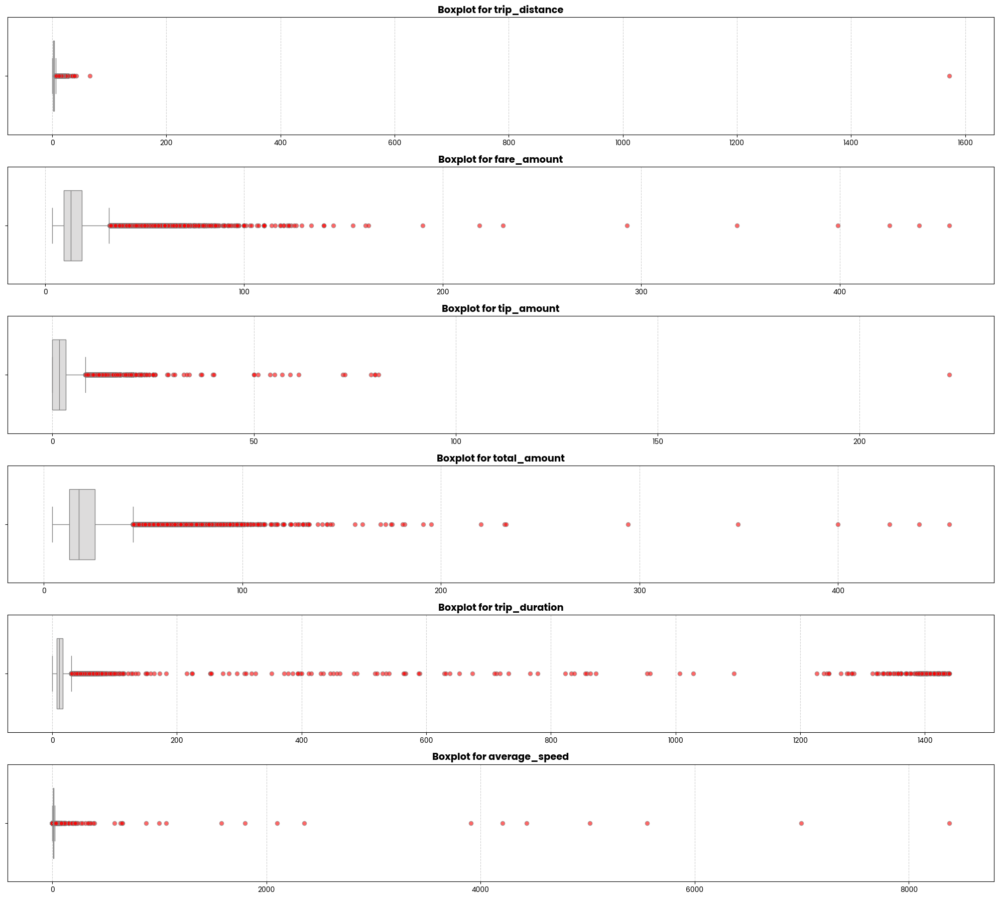

In [45]:
numeric_columns = ['trip_distance', 'fare_amount', 'tip_amount', 'total_amount', 'trip_duration', 'average_speed']

plt.figure(figsize=(20, 18)) 

# Boxplot untuk setiap kolom numerik
for i, col in enumerate(numeric_columns, 1):
    plt.subplot(len(numeric_columns), 1, i)
    sns.boxplot(
        x=df[col], 
        palette="coolwarm", 
        saturation=0.85, 
        width=0.6, 
        flierprops={'marker': 'o', 'markersize': 6, 'markerfacecolor': 'red', 'alpha': 0.6} 
    )
    plt.title(f'Boxplot for {col}', fontsize=14, weight='bold')  
    plt.grid(True, axis='x', linestyle='--', alpha=0.6) 
    plt.xlabel('') 

plt.tight_layout()
plt.show()


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>

Berdasarkan boxplot yang dihasilkan, terdapat beberapa temuan penting terkait distribusi data pada setiap fitur:

1. **Outliers yang Signifikan:**
   - Hampir semua fitur menunjukkan adanya outliers, yang ditandai dengan titik-titik yang terpisah jauh dari kotak utama dalam boxplot. Hal ini terutama terlihat pada `trip_distance`, `fare_amount`, `tip_amount`, dan `total_amount`. 
   - Nilai outlier ini menunjukkan perjalanan yang sangat jauh, tarif yang tidak wajar, atau durasi perjalanan yang luar biasa panjang.

2. **Keterkaitan Outliers dengan Nilai yang Tidak Masuk Akal:**
   - Nilai-nilai seperti `fare_amount` yang sangat rendah atau `trip_distance` yang mencapai ratusan hingga ribuan mil jelas merupakan anomali yang perlu diperbaiki. 

3. **Perlu Dilakukan Normalisasi dan Pembersihan Data:**
   - Dengan jumlah outliers yang cukup signifikan pada berbagai fitur, pembersihan data menjadi sangat penting untuk menghasilkan analisis yang akurat. 

In [46]:
# data dengan trip_duration lebih dari 400 fare_amount rendah
df[df['trip_duration'] > 400].sort_values('trip_duration', ascending=True).head(15)

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,payment_type,trip_type,congestion_surcharge,total_amount,PU_Borough,PU_Zone,PU_ServiceZone,DO_Borough,DO_Zone,DO_ServiceZone,trip_duration,day_of_week,pickup_hour,pickup_date,average_speed,day_type
39544,2,2023-01-21 17:19:27,2023-01-22 00:00:00,N,1.0,198,146,11.06,77.2,0.0,0.5,19.68,0.0,1.0,1.0,1.0,0.00,98.38,Queens,Ridgewood,Boro Zone,Queens,Long Island City/Queens Plaza,Boro Zone,400.55,Saturday,17,21,1.656722,Weekend
45382,2,2023-01-24 17:08:13,2023-01-25 00:00:00,N,1.0,66,170,5.91,31.0,2.5,0.5,0.00,0.0,1.0,1.0,1.0,2.75,37.75,Brooklyn,DUMBO/Vinegar Hill,Boro Zone,Manhattan,Murray Hill,Yellow Zone,411.78,Tuesday,17,24,0.861139,Weekday
45280,2,2023-01-24 17:04:23,2023-01-25 00:00:00,N,1.0,95,160,2.35,16.3,2.5,0.5,0.00,0.0,1.0,1.0,1.0,0.00,20.30,Queens,Forest Hills,Boro Zone,Queens,Middle Village,Boro Zone,415.62,Tuesday,17,24,0.339252,Weekday
43093,2,2023-01-23 16:48:51,2023-01-24 00:00:00,N,1.0,95,121,2.67,14.9,2.5,0.5,0.00,0.0,1.0,2.0,1.0,0.00,18.90,Queens,Forest Hills,Boro Zone,Queens,Hillcrest/Pomonok,Boro Zone,431.15,Monday,16,23,0.371564,Weekday
23967,2,2023-01-13 16:45:34,2023-01-14 00:00:00,N,1.0,65,261,3.15,18.0,1.0,0.5,6.76,0.0,0.3,1.0,1.0,2.75,29.31,Brooklyn,Downtown Brooklyn/MetroTech,Boro Zone,Manhattan,World Trade Center,Yellow Zone,434.43,Friday,16,13,0.435053,Weekday
13776,2,2023-01-08 16:34:03,2023-01-09 00:00:00,N,1.0,74,239,3.55,18.4,0.0,0.5,2.26,0.0,1.0,1.0,1.0,2.75,24.91,Manhattan,East Harlem North,Boro Zone,Manhattan,Upper West Side South,Yellow Zone,445.95,Sunday,16,08,0.477632,Weekend
13759,2,2023-01-08 16:28:51,2023-01-09 00:00:00,N,5.0,33,54,0.27,25.0,0.0,0.0,2.60,0.0,1.0,1.0,2.0,0.00,28.60,Brooklyn,Brooklyn Heights,Boro Zone,Brooklyn,Columbia Street,Boro Zone,451.15,Sunday,16,08,0.035908,Weekend
7915,2,2023-01-05 16:23:19,2023-01-06 00:00:00,N,1.0,75,230,2.94,18.0,1.0,0.5,4.51,0.0,0.3,1.0,1.0,2.75,27.06,Manhattan,East Harlem South,Boro Zone,Manhattan,Times Sq/Theatre District,Yellow Zone,456.68,Thursday,16,05,0.386266,Weekday
7265,2,2023-01-05 12:12:49,2023-01-05 19:53:49,N,1.0,223,223,25.48,348.1,0.0,0.5,0.00,0.0,1.0,2.0,1.0,0.00,349.60,Queens,Steinway,Boro Zone,Queens,Steinway,Boro Zone,461.00,Thursday,12,05,3.316269,Weekday
57327,2,2023-01-30 15:55:56,2023-01-31 00:00:00,N,1.0,42,74,1.28,12.8,0.0,0.5,2.14,0.0,1.0,1.0,1.0,0.00,16.44,Manhattan,Central Harlem North,Boro Zone,Manhattan,East Harlem North,Boro Zone,484.07,Monday,15,30,0.158655,Weekday


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Mengidentifikasi outlier yang tidak masuk akal berdasarkan kriteria

In [47]:
# Kecepatan yang tidak masuk akal untuk rata rata kecepatan pada perjalanan NYC
unreasonable_speed = df[(df['average_speed'] > 60)]
unreasonable_speed2 = df[(df['average_speed'] < 1) & (df['trip_distance'] > 5) & (df['trip_duration'] < 5)] 

# Kecepatan tinggi dengan jarak pendek (kecepatan > 30 mph dan jarak < 1 mil)
high_speed_short_distance = df[(df['average_speed'] > 30) & (df['trip_distance'] < 1)]

# Durasi sangat lama dengan jarak sangat pendek (durasi > 120 menit dan jarak < 1 mil)
long_duration_short_distance = df[(df['trip_duration'] > 120) & (df['trip_distance'] < 1)]

# durasi sangat lama biaya sangat rendah
unreasonable_duration_distance = pd.concat([
    df[(df['trip_duration'] > 500) & (df['trip_distance'] < 20)],
    df[(df['trip_duration'] > 400) & (df['trip_distance'] < 15)]
])

# Durasi sangat pendek dengan jarak jauh (durasi < 1 menit dan jarak > 5 mil)
short_duration_long_distance = df[(df['trip_duration'] < 1) & (df['trip_distance'] > 5)]

# Tarif yang tidak seimbang dengan jarak perjalanan (misalnya jarak < 1 mil tapi tarif > $50)
unreasonable_fare = pd.concat([
    df[(df['fare_amount'] < 2) & (df['trip_distance'] > 5)], # Tarif terlalu rendah
    df[(df['fare_amount'] < 20) & (df['trip_distance'] > 60)],  # Tarif terlalu rendah
    df[(df['fare_amount'] > 50) & (df['trip_distance'] < 2)]  # Tarif terlalu tinggi
])

# Payment Type yang tidak sesuai (misalnya, "No Charge" atau "Dispute" untuk perjalanan jauh)
unreasonable_payment_type = df[
    (df['payment_type'].isin([3, 4])) &  # No Charge or Dispute
    (df['trip_distance'] > 5)  # Perjalanan jauh
]

# Jarak hampir nol tetapi durasi dan tarif tinggi
zero_distance_high_fare = df[
    (df['trip_distance'] < 0.1) & (df['fare_amount'] > 20) & (df['trip_duration'] > 10)
]

# Perjalanan sangat panjang dengan tarif tidak wajar (misalnya jarak > 10 mil dengan tarif < $10)
long_trip_unreasonable_fare = df[
    (df['trip_distance'] > 10) & (df['fare_amount'] < 10)
]

all_unreasonable_outliers = pd.concat([
    unreasonable_speed,
    unreasonable_speed2,
    unreasonable_duration_distance,
    high_speed_short_distance,
    long_duration_short_distance,
    short_duration_long_distance,
    unreasonable_fare,
    unreasonable_payment_type,
    zero_distance_high_fare,
    long_trip_unreasonable_fare
])

all_unreasonable_outliers.shape

(674, 30)

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Drop seluruh value dengan extreme outlier

In [48]:
# drop seluruh outlier
df.drop(all_unreasonable_outliers.index, inplace=True)

In [49]:
df.describe(include=['number'])

,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,congestion_surcharge,total_amount,trip_duration,average_speed
count,59570.000000,59570.000000,59570.000000,59570.000000,59570.000000,59570.000000,59570.000000,59570.000000,59570.000000,59570.000000,59570.000000
mean,2.657244,15.701248,0.919939,0.619414,2.108332,0.125738,0.956151,0.768336,21.199158,13.402899,11.735384
std,2.485710,10.718152,1.305717,0.338072,2.908557,0.929261,0.170335,1.233872,12.968323,10.640044,5.134642
min,0.010000,3.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.300000,0.030000,0.026178
25%,1.210000,9.300000,0.000000,0.500000,0.000000,0.000000,1.000000,0.000000,12.900000,7.320000,8.508791
50%,1.890000,12.800000,0.000000,0.500000,1.720000,0.000000,1.000000,0.000000,17.680000,11.150000,10.565958
75%,3.150000,18.400000,2.500000,0.500000,3.300000,0.000000,1.000000,2.750000,25.560000,16.630000,13.521831
max,41.740000,348.100000,7.500000,1.500000,222.220000,36.050000,1.000000,2.750000,349.600000,461.000000,57.142857


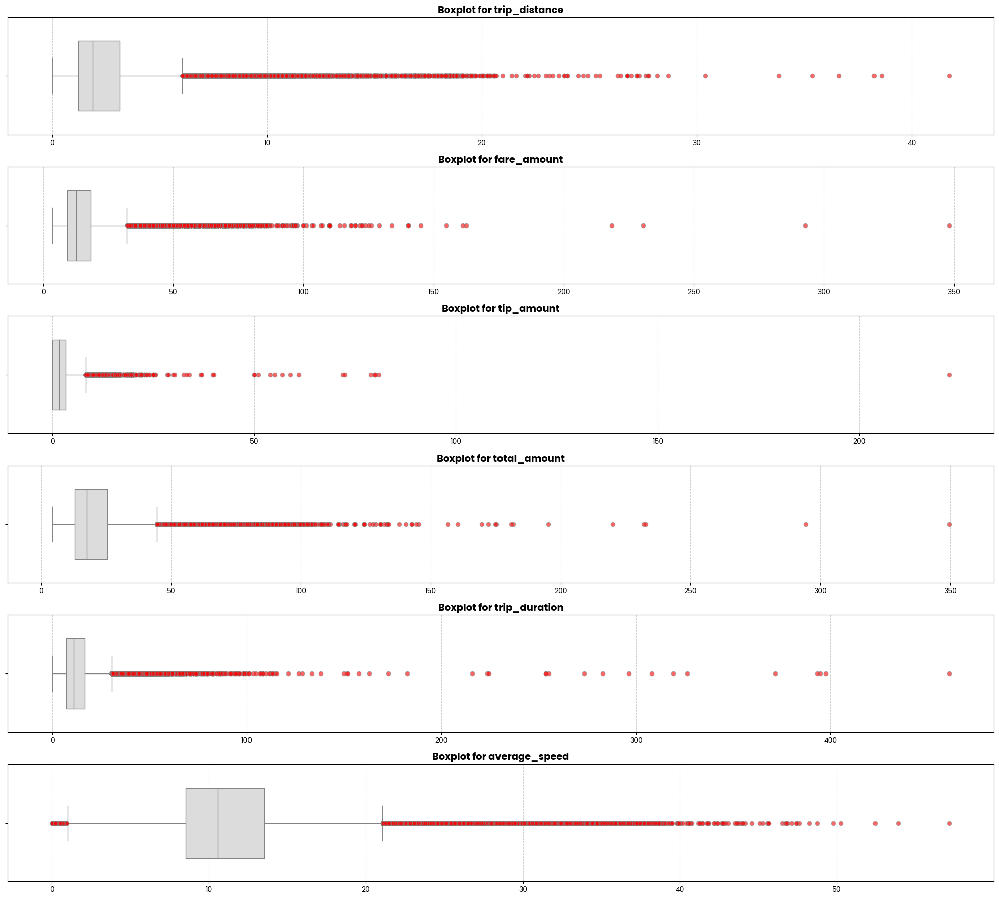

In [50]:
numeric_columns = ['trip_distance', 'fare_amount', 'tip_amount', 'total_amount', 'trip_duration', 'average_speed']

plt.figure(figsize=(20, 18)) 

# Boxplot untuk setiap kolom numerik
for i, col in enumerate(numeric_columns, 1):
    plt.subplot(len(numeric_columns), 1, i)
    sns.boxplot(
        x=df[col], 
        palette="coolwarm", 
        saturation=0.85, 
        width=0.6, 
        flierprops={'marker': 'o', 'markersize': 6, 'markerfacecolor': 'red', 'alpha': 0.6} 
    )
    plt.title(f'Boxplot for {col}', fontsize=14, weight='bold')  
    plt.grid(True, axis='x', linestyle='--', alpha=0.6) 
    plt.xlabel('') 

plt.tight_layout()
plt.show()

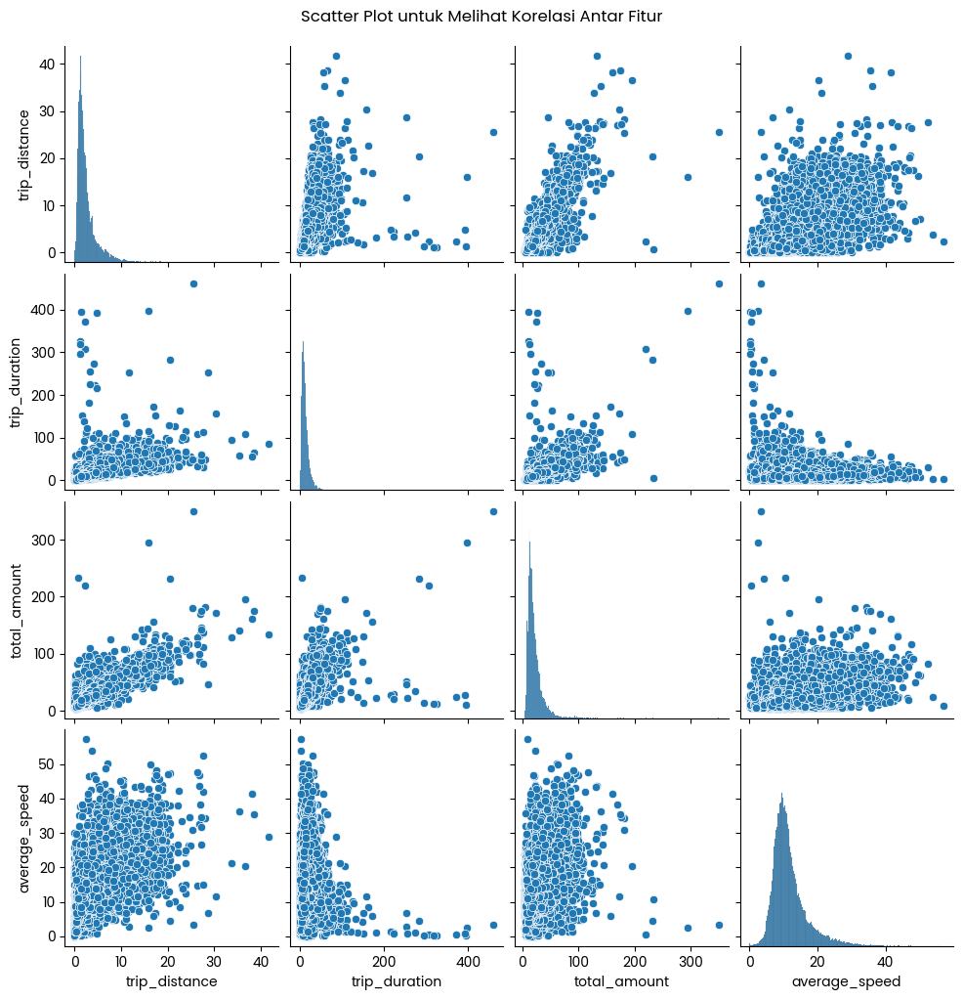

In [51]:
numerical_features = ['trip_distance', 'trip_duration', 'total_amount', 'average_speed']

# Membuat pairplot untuk melihat korelasi antar fitur
sns.pairplot(df[numerical_features])
plt.suptitle("Scatter Plot untuk Melihat Korelasi Antar Fitur", y=1.02)
plt.show()

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Berdasarkan scatter plot di atas yang memperlihatkan hubungan antar fitur dalam dataset, berikut adalah beberapa pernyataan yang dapat diambil:

1. **Trip Distance dan Total Amount**:
   - Terdapat korelasi positif yang cukup jelas antara `trip_distance` dan `total_amount`. Semakin jauh jarak perjalanan (`trip_distance`), semakin besar jumlah yang dibayarkan (`total_amount`). Namun, ada beberapa outlier yang menunjukkan pembayaran tinggi meskipun jaraknya tidak terlalu jauh (bisa terjadi apabila durasi perjalanan cenderung lama).

2. **Trip Distance dan Trip Duration**:
   - Jarak (`trip_distance`) dan durasi perjalanan (`trip_duration`) memiliki korelasi yang positif. Namun, kita melihat adanya variabilitas yang cukup tinggi dalam durasi, terutama pada jarak yang lebih pendek. Ini menunjukkan bahwa untuk jarak yang sama, durasi bisa sangat bervariasi, mungkin karena kondisi lalu lintas.

3. **Trip Distance dan Average Speed**:
   - Hubungan antara jarak dan kecepatan rata-rata (`average_speed`) menunjukkan beberapa pola menarik. Perjalanan dengan jarak pendek cenderung memiliki kecepatan yang lebih rendah, kemungkinan besar karena seringnya berhenti di lampu lalu lintas atau jalanan yang padat.

4. **Trip Duration dan Average Speed**:
   - Ada korelasi negatif antara durasi perjalanan (`trip_duration`) dan kecepatan rata-rata (`average_speed`). Perjalanan yang lebih lama biasanya terjadi pada kecepatan rata-rata yang lebih rendah, yang masuk akal mengingat kondisi lalu lintas yang mungkin padat.

5. **Total Amount dan Trip Duration**:
   - Total pembayaran (`total_amount`) tampaknya meningkat dengan bertambahnya durasi perjalanan, tetapi hubungan ini tidak sekuat hubungan antara jarak dan total pembayaran. Ini mungkin dipengaruhi oleh tarif tetap untuk perjalanan tertentu atau tambahan biaya (seperti tol atau biaya tambahan waktu sibuk).

6. **Distribusi Fitur**:
   - Histograms di diagonal menunjukkan distribusi dari masing-masing fitur. Distribusi `trip_distance`, `trip_duration`, dan `average_speed` tampak sangat skewed ke positif, menunjukkan bahwa mayoritas perjalanan adalah perjalanan jarak pendek dan berlangsung dalam waktu singkat dengan kecepatan rendah.

Kesimpulan dari scatter plot ini menunjukkan bahwa meskipun ada korelasi antara fitur-fitur utama seperti jarak, durasi, dan pembayaran, variabilitas tetap tinggi yang dipengaruhi oleh faktor-faktor eksternal seperti kondisi lalu lintas dan waktu tempuh di area padat.

In [52]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 59570 entries, 0 to 60258
Data columns (total 30 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   VendorID               59570 non-null  category      
 1   lpep_pickup_datetime   59570 non-null  datetime64[ns]
 2   lpep_dropoff_datetime  59570 non-null  datetime64[ns]
 3   store_and_fwd_flag     59570 non-null  category      
 4   RatecodeID             59570 non-null  category      
 5   PULocationID           59570 non-null  category      
 6   DOLocationID           59570 non-null  category      
 7   trip_distance          59570 non-null  float64       
 8   fare_amount            59570 non-null  float64       
 9   extra                  59570 non-null  float64       
 10  mta_tax                59570 non-null  float64       
 11  tip_amount             59570 non-null  float64       
 12  tolls_amount           59570 non-null  float64       
 13  improv

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
# 5. Data Analysis

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
## 5. 1 Visualisasi distribusi trip berdasarkan waktu pada bulan Januari 2023

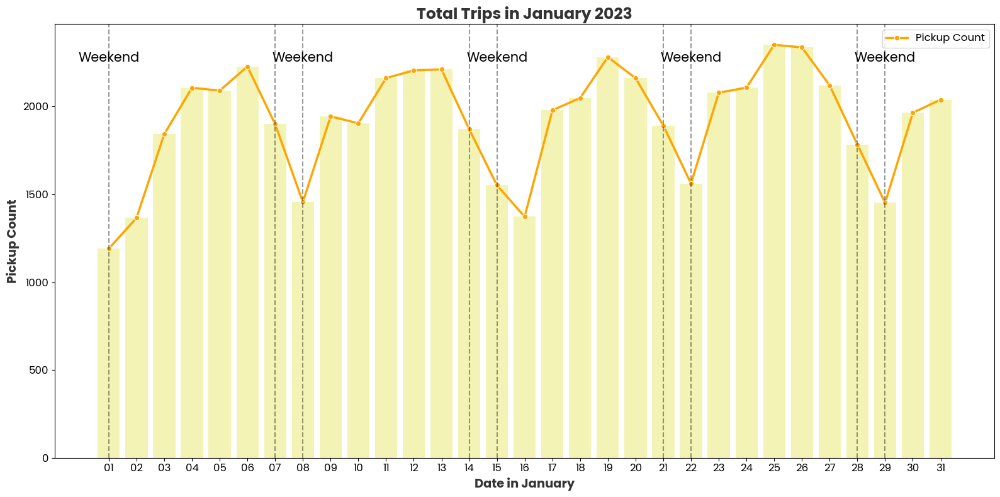

In [53]:
pu_countperday = df.groupby('pickup_date')[['lpep_pickup_datetime']].count().reset_index()


plt.figure(figsize=(16, 8))
sns.barplot(x='pickup_date', y='lpep_pickup_datetime', data=pu_countperday, color='#fdfd96', alpha=0.8)
sns.lineplot(x='pickup_date', y='lpep_pickup_datetime', data=pu_countperday, marker='o', color='#ffa500', linewidth=2.5, label='Pickup Count')

# AXVline untuk hari sunday
axvline = np.arange(0, 31, 7)
for x in axvline:
    plt.axvline(x=x, color="black", alpha=0.4, linestyle='--')
    plt.text(x, pu_countperday['lpep_pickup_datetime'].max() * 0.95, "Weekend", color="black", ha='center', va='bottom', fontsize=15)

axvline = np.arange(6, 31, 7)
for x in axvline:
    plt.axvline(x=x, color="black", alpha=0.4, linestyle='--')

plt.xlabel('Date in January', fontsize=14, fontweight='bold', color='#333333')
plt.ylabel('Pickup Count', fontsize=14, fontweight='bold', color='#333333')
plt.title('Total Trips in January 2023', fontsize=18, fontweight='bold', color='#333333')
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)


plt.legend(loc='upper right', fontsize=12)

plt.tight_layout()
plt.show()

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Berdasarkan grafik di atas, terlihat adanya pola dalam setiap yang konsisten dengan fluktuasi jumlah perjalanan harian selama periode satu bulan (Januari 2023). Terdapat tren peningkatan pada weekday dan penurunan volume perjalanan yang teratur setiap weekend.

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
## 5. 2 Visualisasi distribusi rata rata trip berdasarkan hari pada bulan Januari 2023

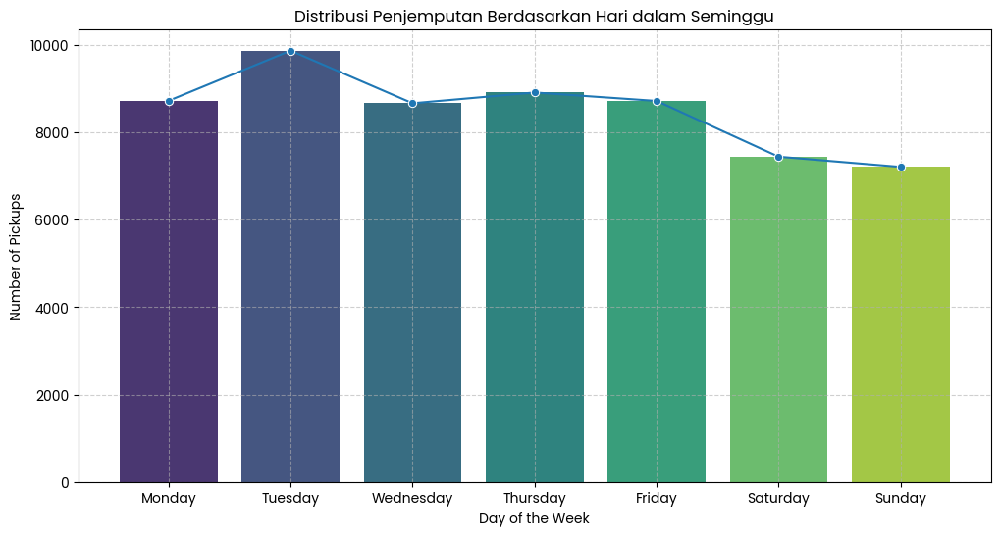

In [54]:
# Visualisasi distribusi penjemputan berdasarkan hari
plt.figure(figsize=(12, 6))
sns.countplot(x='day_of_week', data=df, order=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'], palette='viridis')
sns.lineplot(x=df['day_of_week'].value_counts().sort_index().index, y=df['day_of_week'].value_counts().sort_index().values, marker='o', palette='viridis')

plt.title('Distribusi Penjemputan Berdasarkan Hari dalam Seminggu')
plt.xlabel('Day of the Week')
plt.ylabel('Number of Pickups')
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Aktivitas penjemputan tertinggi terjadi pada hari kerja, dengan puncak pada Selasa, sementara akhir pekan cenderung lebih sepi. Ini bisa menunjukkan bahwa penggunaan taksi di area tersebut lebih banyak didorong oleh keperluan terkait pekerjaan atau aktivitas di hari kerja. Untuk mendapatkan pemahaman yang lebih mendalam, mari kita lanjutkan dengan menganalisis distribusi jumlah perjalanan pada waktu-waktu tertentu, khususnya berdasarkan jam dalam sehari.

Selanjutnya akan dilakukan analisa lebih mendalam terhadap weekend dan weekday.

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
### 5. 2. 1 Analisa Waktu Pickup pada Weekend Weekday

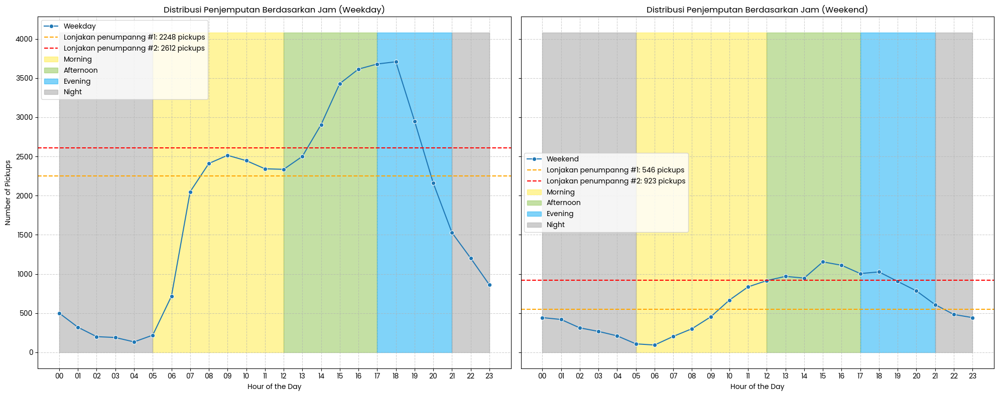

In [55]:
# Menghitung jumlah penjemputan berdasarkan jam untuk weekday dan weekend
weekday_pickups = df[df['day_type'] == 'Weekday']['pickup_hour'].value_counts().sort_index()
weekend_pickups = df[df['day_type'] == 'Weekend']['pickup_hour'].value_counts().sort_index()

weekday_pickups_index = weekday_pickups.index.astype(int)
weekend_pickups_index = weekend_pickups.index.astype(int)

# Menentukan threshold untuk weekday
weekday_threshold_first = weekday_pickups.quantile(0.5)
weekday_threshold_second = weekday_pickups.quantile(0.75)

# Menentukan threshold untuk weekend
weekend_threshold_first = weekend_pickups.quantile(0.5)
weekend_threshold_second = weekend_pickups.quantile(0.75)

# Plot untuk Weekday
fig, axes = plt.subplots(1, 2, figsize=(20, 8), sharey=True)

# Plot untuk Weekday
sns.lineplot(ax=axes[0], x=weekday_pickups.index, y=weekday_pickups.values, marker='o', palette='Set2', label='Weekday')
axes[0].axhline(y=weekday_threshold_first, color='orange', linestyle='--', label=f'Lonjakan penumpanng #1: {round(weekday_threshold_first)} pickups')
axes[0].axhline(y=weekday_threshold_second, color='red', linestyle='--', label=f'Lonjakan penumpanng #2: {round(weekday_threshold_second)} pickups')

axes[0].fill_between(weekday_pickups_index, 0, weekday_pickups.values.max() *1.1, 
                     where=(weekday_pickups_index >= 5) & (weekday_pickups_index <= 12), color='#FFEB3B', alpha=0.5, label='Morning')
axes[0].fill_between(weekday_pickups_index, 0, weekday_pickups.values.max() *1.1, 
                     where=(weekday_pickups_index >= 12) & (weekday_pickups_index <= 17), color='#8BC34A', alpha=0.5, label='Afternoon')
axes[0].fill_between(weekday_pickups_index, 0, weekday_pickups.values.max() *1.1, 
                     where=(weekday_pickups_index >= 17) & (weekday_pickups_index <= 21), color='#03A9F4', alpha=0.5, label='Evening')
axes[0].fill_between(weekday_pickups_index, 0, weekday_pickups.values.max() *1.1, 
                     where=(weekday_pickups_index >= 21) | (weekday_pickups_index <= 5), color='#9E9E9E', alpha=0.5, label='Night')

axes[0].set_title('Distribusi Penjemputan Berdasarkan Jam (Weekday)')
axes[0].set_xlabel('Hour of the Day')
axes[0].set_ylabel('Number of Pickups')
axes[0].grid(True, linestyle='--', alpha=0.6)
axes[0].set_xticks(range(0, 24))
axes[0].legend(loc='upper left')

# Plot untuk Weekend
sns.lineplot(ax=axes[1], x=weekend_pickups.index, y=weekend_pickups.values, marker='o', palette='Set3', label='Weekend')
axes[1].axhline(y=weekend_threshold_first, color='orange', linestyle='--', label=f'Lonjakan penumpanng #1: {round(weekend_threshold_first)} pickups')
axes[1].axhline(y=weekend_threshold_second, color='red', linestyle='--', label=f'Lonjakan penumpanng #2: {round(weekend_threshold_second)} pickups')

axes[1].fill_between(weekend_pickups_index, 0, weekday_pickups.values.max() *1.1, 
                     where=(weekend_pickups_index >= 5) & (weekend_pickups_index <= 12), color='#FFEB3B', alpha=0.5, label='Morning')
axes[1].fill_between(weekend_pickups_index, 0, weekday_pickups.values.max() *1.1, 
                     where=(weekend_pickups_index >= 12) & (weekend_pickups_index <= 17), color='#8BC34A', alpha=0.5, label='Afternoon')
axes[1].fill_between(weekend_pickups_index, 0, weekday_pickups.values.max() *1.1, 
                     where=(weekend_pickups_index >= 17) & (weekend_pickups_index <= 21), color='#03A9F4', alpha=0.5, label='Evening')
axes[1].fill_between(weekend_pickups_index, 0, weekday_pickups.values.max() *1.1, 
                     where=(weekend_pickups_index >= 21) | (weekend_pickups_index <= 5), color='#9E9E9E', alpha=0.5, label='Night')

axes[1].set_title('Distribusi Penjemputan Berdasarkan Jam (Weekend)')
axes[1].set_xlabel('Hour of the Day')
axes[1].grid(True, linestyle='--', alpha=0.6)
axes[1].set_xticks(range(0, 24))
axes[1].legend()

plt.tight_layout()
plt.show()

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Grafik di atas menunjukkan perbedaan pola penjemputan antara hari kerja (weekday) dan akhir pekan (weekend) di New York City.

**Weekday:**
- Terdapat dua lonjakan utama: pagi (07:00 - 09:00) dan sore (17:00 - 19:00).
- Puncak aktivitas terjadi pada pagi hari dengan 2,612 penjemputan, dan sore hari dengan 2,248 penjemputan.
- Aktivitas penjemputan tinggi berlangsung dari pagi hingga malam dengan penurunan signifikan setelah pukul 21:00.

**Weekend:**
- Aktivitas lebih merata dengan lonjakan terjadi pada siang hari (12:00 - 15:00) dan sore (16:00 - 18:00).
- Puncak penjemputan terjadi siang hari dengan 923 penjemputan, menunjukkan fokus pada kegiatan sosial dan rekreasi.

Perbedaan utama antara weekday dan weekend terletak pada intensitas dan waktu lonjakan penjemputan, di mana weekday didominasi oleh jam sibuk pagi dan sore, sedangkan weekend lebih fokus pada siang hingga sore hari.

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
### 5. 2. 2 Analisa Waktu dengan rata - rata panjang perjalanan pada Weekend Weekday

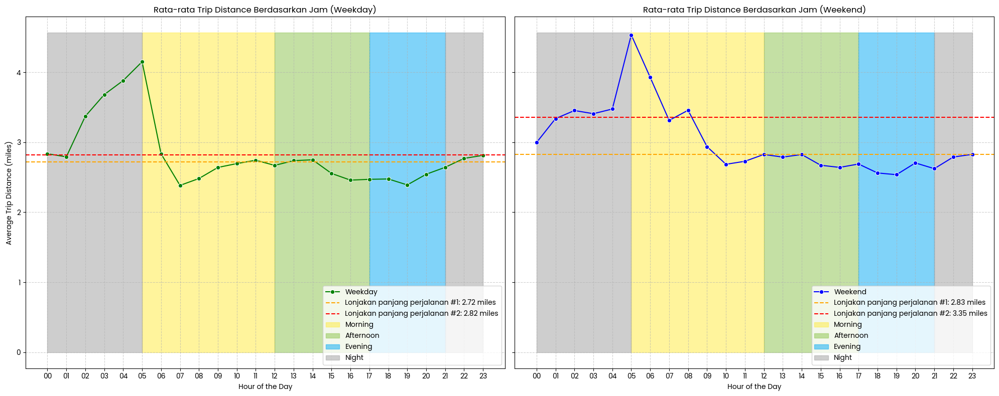

In [56]:
weekday_avg_distance = df[df['day_type'] == 'Weekday'].groupby('pickup_hour')['trip_distance'].mean().sort_index()
weekend_avg_distance = df[df['day_type'] == 'Weekend'].groupby('pickup_hour')['trip_distance'].mean().sort_index()

weekday_pickups_index = weekday_avg_distance.index.astype(int)
weekend_pickups_index = weekend_avg_distance.index.astype(int)

# Menentukan threshold untuk weekday trip_distance
weekday_distance_threshold_first = weekday_avg_distance.quantile(0.5)
weekday_distance_threshold_second = weekday_avg_distance.quantile(0.75)

# Menentukan threshold untuk weekend trip_distance
weekend_distance_threshold_first = weekend_avg_distance.quantile(0.5)
weekend_distance_threshold_second = weekend_avg_distance.quantile(0.75)

fig, axes = plt.subplots(1, 2, figsize=(20, 8), sharey=True)

# Plot untuk Weekday
sns.lineplot(ax=axes[0], x=weekday_avg_distance.index, y=weekday_avg_distance.values, marker='o', color='green', label='Weekday')
axes[0].axhline(y=weekday_distance_threshold_first, color='orange', linestyle='--', label=f'Lonjakan panjang perjalanan #1: {round(weekday_distance_threshold_first, 2)} miles')
axes[0].axhline(y=weekday_distance_threshold_second, color='red', linestyle='--', label=f'Lonjakan panjang perjalanan #2: {round(weekday_distance_threshold_second, 2)} miles')

axes[0].fill_between(weekday_pickups_index, 0, weekday_avg_distance.values.max() * 1.1, 
                     where=(weekday_pickups_index >= 5) & (weekday_pickups_index <= 12), color='#FFEB3B', alpha=0.5, label='Morning')
axes[0].fill_between(weekday_pickups_index, 0, weekday_avg_distance.values.max() * 1.1, 
                     where=(weekday_pickups_index >= 12) & (weekday_pickups_index <= 17), color='#8BC34A', alpha=0.5, label='Afternoon')
axes[0].fill_between(weekday_pickups_index, 0, weekday_avg_distance.values.max() * 1.1, 
                     where=(weekday_pickups_index >= 17) & (weekday_pickups_index <= 21), color='#03A9F4', alpha=0.5, label='Evening')
axes[0].fill_between(weekday_pickups_index, 0, weekday_avg_distance.values.max() * 1.1, 
                     where=(weekday_pickups_index >= 21) | (weekday_pickups_index <= 5), color='#9E9E9E', alpha=0.5, label='Night')

axes[0].set_title('Rata-rata Trip Distance Berdasarkan Jam (Weekday)')
axes[0].set_xlabel('Hour of the Day')
axes[0].set_ylabel('Average Trip Distance (miles)')
axes[0].grid(True, linestyle='--', alpha=0.6)
axes[0].set_xticks(range(0, 24))
axes[0].legend(loc='lower right')

# Plot untuk Weekend
sns.lineplot(ax=axes[1], x=weekend_avg_distance.index, y=weekend_avg_distance.values, marker='o', color='blue', label='Weekend')
axes[1].axhline(y=weekend_distance_threshold_first, color='orange', linestyle='--', label=f'Lonjakan panjang perjalanan #1: {round(weekend_distance_threshold_first, 2)} miles')
axes[1].axhline(y=weekend_distance_threshold_second, color='red', linestyle='--', label=f'Lonjakan panjang perjalanan #2: {round(weekend_distance_threshold_second, 2)} miles')

axes[1].fill_between(weekend_pickups_index, 0, weekday_avg_distance.values.max() * 1.1, 
                     where=(weekend_pickups_index >= 5) & (weekend_pickups_index <= 12), color='#FFEB3B', alpha=0.5, label='Morning')
axes[1].fill_between(weekend_pickups_index, 0, weekday_avg_distance.values.max() * 1.1, 
                     where=(weekend_pickups_index >= 12) & (weekend_pickups_index <= 17), color='#8BC34A', alpha=0.5, label='Afternoon')
axes[1].fill_between(weekend_pickups_index, 0, weekday_avg_distance.values.max() * 1.1, 
                     where=(weekend_pickups_index >= 17) & (weekend_pickups_index <= 21), color='#03A9F4', alpha=0.5, label='Evening')
axes[1].fill_between(weekend_pickups_index, 0, weekday_avg_distance.values.max() * 1.1, 
                     where=(weekend_pickups_index >= 21) | (weekend_pickups_index <= 5), color='#9E9E9E', alpha=0.5, label='Night')

axes[1].set_title('Rata-rata Trip Distance Berdasarkan Jam (Weekend)')
axes[1].set_xlabel('Hour of the Day')
axes[1].grid(True, linestyle='--', alpha=0.6)
axes[1].set_xticks(range(0, 24))
axes[1].legend(loc='lower right')

plt.tight_layout()
plt.show()


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Grafik distribusi rata-rata jarak perjalanan di bulan Januari 2023 menunjukkan perbedaan pola antara weekday dan weekend:

**Weekday:**
- Rata-rata jarak perjalanan tertinggi terjadi pada dini hari (00:00 - 05:00), dengan puncak sekitar pukul 04:00.
- Setelah pukul 05:00, jarak perjalanan menurun dan stabil sepanjang hari, mencerminkan perjalanan rutin seperti ke tempat kerja.
- Malam hari menunjukkan sedikit peningkatan jarak, namun tetap lebih rendah dibandingkan dini hari.

**Weekend:**
- Lonjakan jarak perjalanan lebih tajam pada dini hari dengan puncak signifikan sekitar pukul 04:00.
- Siang hari menunjukkan jarak yang lebih stabil dan sedikit lebih panjang dibandingkan weekday.
- Pada malam hari, jarak perjalanan tetap tinggi, menunjukkan aktivitas sosial dan rekreasi hingga malam.

Perbedaan utamanya terletak pada weekday yang didominasi perjalanan pendek selama jam sibuk, sementara weekend memiliki pola perjalanan yang lebih panjang dan stabil sepanjang hari.

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
### 5. 2. 3 Analisa Waktu dengan rata - rata pendapatan per perjalanan pada Weekend Weekday

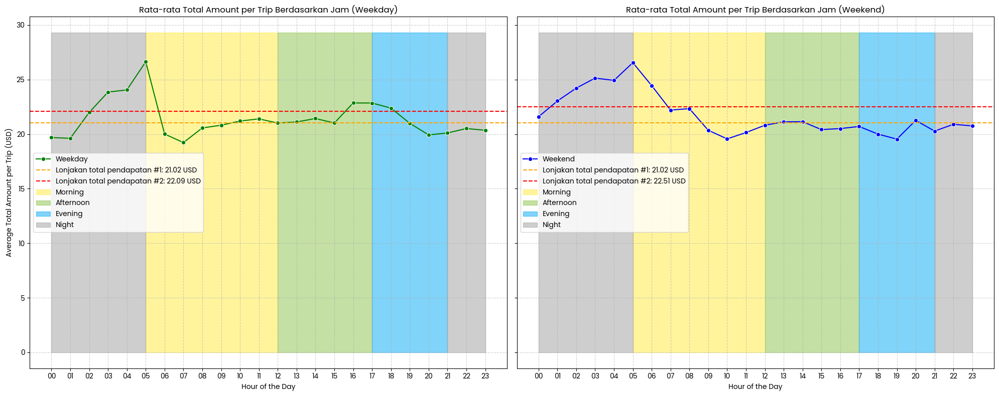

In [57]:
weekday_avg_amount = df[df['day_type'] == 'Weekday'].groupby('pickup_hour')['total_amount'].mean().sort_index()
weekend_avg_amount = df[df['day_type'] == 'Weekend'].groupby('pickup_hour')['total_amount'].mean().sort_index()

weekday_pickups_index = weekday_avg_amount.index.astype(int)
weekend_pickups_index = weekend_avg_amount.index.astype(int)

# Menentukan threshold untuk weekday total_amount
weekday_amount_threshold_first = weekday_avg_amount.quantile(0.5)
weekday_amount_threshold_second = weekday_avg_amount.quantile(0.75)

# Menentukan threshold untuk weekend total_amount
weekend_amount_threshold_first = weekend_avg_amount.quantile(0.5)
weekend_amount_threshold_second = weekend_avg_amount.quantile(0.75)

# Plot untuk Weekday dan Weekend total_amount berdampingan
fig, axes = plt.subplots(1, 2, figsize=(20, 8), sharey=True)

# Plot untuk Weekday
sns.lineplot(ax=axes[0], x=weekday_avg_amount.index, y=weekday_avg_amount.values, marker='o', color='green', label='Weekday')
axes[0].axhline(y=weekday_amount_threshold_first, color='orange', linestyle='--', label=f'Lonjakan total pendapatan #1: {round(weekday_amount_threshold_first, 2)} USD')
axes[0].axhline(y=weekday_amount_threshold_second, color='red', linestyle='--', label=f'Lonjakan total pendapatan #2: {round(weekday_amount_threshold_second, 2)} USD')

axes[0].fill_between(weekday_pickups_index, 0, weekday_avg_amount.values.max() * 1.1, 
                     where=(weekday_pickups_index >= 5) & (weekday_pickups_index <= 12), color='#FFEB3B', alpha=0.5, label='Morning')
axes[0].fill_between(weekday_pickups_index, 0, weekday_avg_amount.values.max() * 1.1, 
                     where=(weekday_pickups_index >= 12) & (weekday_pickups_index <= 17), color='#8BC34A', alpha=0.5, label='Afternoon')
axes[0].fill_between(weekday_pickups_index, 0, weekday_avg_amount.values.max() * 1.1, 
                     where=(weekday_pickups_index >= 17) & (weekday_pickups_index <= 21), color='#03A9F4', alpha=0.5, label='Evening')
axes[0].fill_between(weekday_pickups_index, 0, weekday_avg_amount.values.max() * 1.1, 
                     where=(weekday_pickups_index >= 21) | (weekday_pickups_index <= 5), color='#9E9E9E', alpha=0.5, label='Night')

axes[0].set_title('Rata-rata Total Amount per Trip Berdasarkan Jam (Weekday)')
axes[0].set_xlabel('Hour of the Day')
axes[0].set_ylabel('Average Total Amount per Trip (USD)')
axes[0].grid(True, linestyle='--', alpha=0.6)
axes[0].set_xticks(range(0, 24))
axes[0].legend()

# Plot untuk Weekend
sns.lineplot(ax=axes[1], x=weekend_avg_amount.index, y=weekend_avg_amount.values, marker='o', color='blue', label='Weekend')
axes[1].axhline(y=weekend_amount_threshold_first, color='orange', linestyle='--', label=f'Lonjakan total pendapatan #1: {round(weekend_amount_threshold_first, 2)} USD')
axes[1].axhline(y=weekend_amount_threshold_second, color='red', linestyle='--', label=f'Lonjakan total pendapatan #2: {round(weekend_amount_threshold_second, 2)} USD')

axes[1].fill_between(weekend_pickups_index, 0, weekday_avg_amount.values.max() * 1.1, 
                     where=(weekend_pickups_index >= 5) & (weekend_pickups_index <= 12), color='#FFEB3B', alpha=0.5, label='Morning')
axes[1].fill_between(weekend_pickups_index, 0, weekday_avg_amount.values.max() * 1.1, 
                     where=(weekend_pickups_index >= 12) & (weekend_pickups_index <= 17), color='#8BC34A', alpha=0.5, label='Afternoon')
axes[1].fill_between(weekend_pickups_index, 0, weekday_avg_amount.values.max() * 1.1, 
                     where=(weekend_pickups_index >= 17) & (weekend_pickups_index <= 21), color='#03A9F4', alpha=0.5, label='Evening')
axes[1].fill_between(weekend_pickups_index, 0, weekday_avg_amount.values.max() * 1.1, 
                     where=(weekend_pickups_index >= 21) | (weekend_pickups_index <= 5), color='#9E9E9E', alpha=0.5, label='Night')

axes[1].set_title('Rata-rata Total Amount per Trip Berdasarkan Jam (Weekend)')
axes[1].set_xlabel('Hour of the Day')
axes[1].grid(True, linestyle='--', alpha=0.6)
axes[1].set_xticks(range(0, 24))
axes[1].legend()

plt.tight_layout()
plt.show()

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Grafik distribusi rata-rata total pendapatan per trip di bulan Januari 2023 menunjukkan bahwa baik pada weekday maupun weekend, pola pendapatan cenderung serupa. Pendapatan per trip tertinggi terjadi pada dini hari, terutama sekitar pukul 04:00, baik pada weekday maupun weekend. Sepanjang pagi hingga sore, pendapatan per trip stabil dan konsisten, dengan sedikit peningkatan di malam hari. Secara keseluruhan, tidak ada perbedaan signifikan antara weekday dan weekend dalam hal pendapatan per trip, menandakan bahwa faktor waktu lebih dominan dalam memengaruhi pola pendapatan dibandingkan jenis harinya.

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
### 5. 2. 4 Analisa Waktu dengan rata - rata pendapatan per hari pada Weekend Weekday

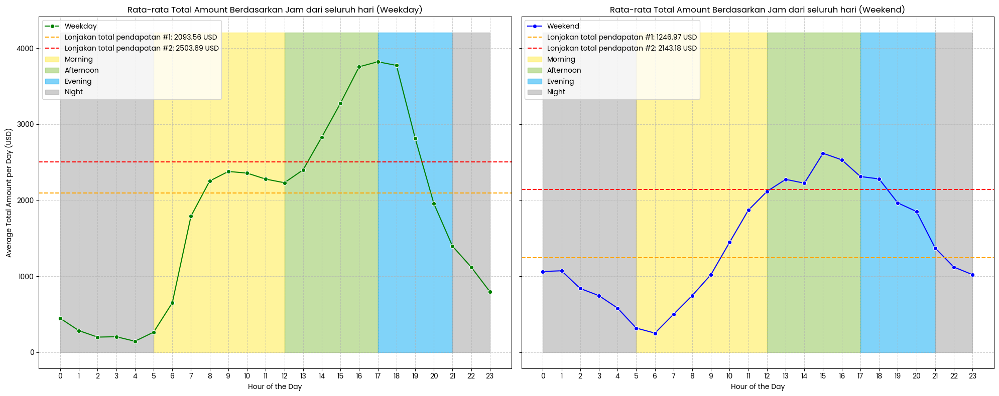

In [58]:
import matplotlib.pyplot as plt
import seaborn as sns

# Menghitung jumlah hari weekday dan weekend dalam dataset
weekday_days = df[df['day_type'] == 'Weekday']['lpep_pickup_datetime'].dt.date.nunique()
weekend_days = df[df['day_type'] == 'Weekend']['lpep_pickup_datetime'].dt.date.nunique()

# Menghitung total pendapatan per jam untuk weekday dan weekend
weekday_total_amount = df[df['day_type'] == 'Weekday'].groupby('pickup_hour')['total_amount'].sum().sort_index()
weekend_total_amount = df[df['day_type'] == 'Weekend'].groupby('pickup_hour')['total_amount'].sum().sort_index()

# Menghitung rata-rata dari seluruh hari pada jam-jam tersebut
weekday_avg_amount_per_hour = (weekday_total_amount / weekday_days).astype(float)
weekend_avg_amount_per_hour = (weekend_total_amount / weekend_days).astype(float)

# Pastikan index berbentuk integer
weekday_avg_amount_per_hour.index = weekday_avg_amount_per_hour.index.astype(int)
weekend_avg_amount_per_hour.index = weekend_avg_amount_per_hour.index.astype(int)

# Menentukan threshold untuk weekday total_amount
weekday_amount_threshold_first = weekday_avg_amount_per_hour.quantile(0.5)
weekday_amount_threshold_second = weekday_avg_amount_per_hour.quantile(0.75)

# Menentukan threshold untuk weekend total_amount
weekend_amount_threshold_first = weekend_avg_amount_per_hour.quantile(0.5)
weekend_amount_threshold_second = weekend_avg_amount_per_hour.quantile(0.75)

# Plot untuk Weekday dan Weekend total_amount berdampingan
fig, axes = plt.subplots(1, 2, figsize=(20, 8), sharey=True)

# Plot untuk Weekday
sns.lineplot(ax=axes[0], x=weekday_avg_amount_per_hour.index, y=weekday_avg_amount_per_hour.values, marker='o', color='green', label='Weekday')
axes[0].axhline(y=weekday_amount_threshold_first, color='orange', linestyle='--', label=f'Lonjakan total pendapatan #1: {round(weekday_amount_threshold_first, 2)} USD')
axes[0].axhline(y=weekday_amount_threshold_second, color='red', linestyle='--', label=f'Lonjakan total pendapatan #2: {round(weekday_amount_threshold_second, 2)} USD')

axes[0].fill_between(weekday_avg_amount_per_hour.index, 0, weekday_avg_amount_per_hour.values.max() * 1.1, 
                     where=(weekday_avg_amount_per_hour.index >= 5) & (weekday_avg_amount_per_hour.index <= 12), color='#FFEB3B', alpha=0.5, label='Morning')
axes[0].fill_between(weekday_avg_amount_per_hour.index, 0, weekday_avg_amount_per_hour.values.max() * 1.1, 
                     where=(weekday_avg_amount_per_hour.index >= 12) & (weekday_avg_amount_per_hour.index <= 17), color='#8BC34A', alpha=0.5, label='Afternoon')
axes[0].fill_between(weekday_avg_amount_per_hour.index, 0, weekday_avg_amount_per_hour.values.max() * 1.1, 
                     where=(weekday_avg_amount_per_hour.index >= 17) & (weekday_avg_amount_per_hour.index <= 21), color='#03A9F4', alpha=0.5, label='Evening')
axes[0].fill_between(weekday_avg_amount_per_hour.index, 0, weekday_avg_amount_per_hour.values.max() * 1.1, 
                     where=(weekday_avg_amount_per_hour.index >= 21) | (weekday_avg_amount_per_hour.index <= 5), color='#9E9E9E', alpha=0.5, label='Night')

axes[0].set_title('Rata-rata Total Amount Berdasarkan Jam dari seluruh hari (Weekday)')
axes[0].set_xlabel('Hour of the Day')
axes[0].set_ylabel('Average Total Amount per Day (USD)')
axes[0].grid(True, linestyle='--', alpha=0.6)
axes[0].set_xticks(range(0, 24))
axes[0].legend(loc='upper left')

# Plot untuk Weekend
sns.lineplot(ax=axes[1], x=weekend_avg_amount_per_hour.index, y=weekend_avg_amount_per_hour.values, marker='o', color='blue', label='Weekend')
axes[1].axhline(y=weekend_amount_threshold_first, color='orange', linestyle='--', label=f'Lonjakan total pendapatan #1: {round(weekend_amount_threshold_first, 2)} USD')
axes[1].axhline(y=weekend_amount_threshold_second, color='red', linestyle='--', label=f'Lonjakan total pendapatan #2: {round(weekend_amount_threshold_second, 2)} USD')

axes[1].fill_between(weekend_avg_amount_per_hour.index, 0, weekday_avg_amount_per_hour.values.max() * 1.1, 
                     where=(weekend_avg_amount_per_hour.index >= 5) & (weekend_avg_amount_per_hour.index <= 12), color='#FFEB3B', alpha=0.5, label='Morning')
axes[1].fill_between(weekend_avg_amount_per_hour.index, 0, weekday_avg_amount_per_hour.values.max() * 1.1, 
                     where=(weekend_avg_amount_per_hour.index >= 12) & (weekend_avg_amount_per_hour.index <= 17), color='#8BC34A', alpha=0.5, label='Afternoon')
axes[1].fill_between(weekend_avg_amount_per_hour.index, 0, weekday_avg_amount_per_hour.values.max() * 1.1, 
                     where=(weekend_avg_amount_per_hour.index >= 17) & (weekend_avg_amount_per_hour.index <= 21), color='#03A9F4', alpha=0.5, label='Evening')
axes[1].fill_between(weekend_avg_amount_per_hour.index, 0, weekday_avg_amount_per_hour.values.max() * 1.1, 
                     where=(weekend_avg_amount_per_hour.index >= 21) | (weekend_avg_amount_per_hour.index <= 5), color='#9E9E9E', alpha=0.5, label='Night')

axes[1].set_title('Rata-rata Total Amount Berdasarkan Jam dari seluruh hari (Weekend)')
axes[1].set_xlabel('Hour of the Day')
axes[1].grid(True, linestyle='--', alpha=0.6)
axes[1].set_xticks(range(0, 24))
axes[1].legend(loc='upper left')

plt.tight_layout()
plt.show()

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Grafik distribusi rata-rata total pendapatan per hari berdasarkan jam pada weekday dan weekend menunjukkan perbedaan signifikan dalam pola pendapatan.

**Weekday:**
- Rata-rata total pendapatan per hari mencapai puncaknya antara pukul 08:00 hingga 10:00, dengan penurunan bertahap setelah jam tersebut hingga malam hari.
- Periode pagi hingga sore (05:00-18:00) menjadi waktu dengan kontribusi terbesar terhadap pendapatan, dengan lonjakan utama di pagi hari.
- Threshold lonjakan pendapatan pertama berada di sekitar 2.093 USD dan yang kedua di 2.503 USD.

**Weekend:**
- Rata-rata total pendapatan per hari mengalami lonjakan yang lebih merata di siang hari, dengan puncak pendapatan sekitar pukul 12:00 hingga 14:00.
- Pagi hari hingga sore (06:00-17:00) menunjukkan stabilitas dalam kontribusi pendapatan dengan penurunan setelahnya.
- Threshold lonjakan pendapatan pertama di 1.246 USD dan yang kedua di 2.143 USD.

Secara keseluruhan, weekday cenderung memiliki pendapatan yang lebih tinggi dengan konsentrasi pada jam-jam sibuk di pagi hari, sedangkan weekend menunjukkan pola yang lebih seimbang dengan puncak pendapatan yang lebih terfokus di siang hari.

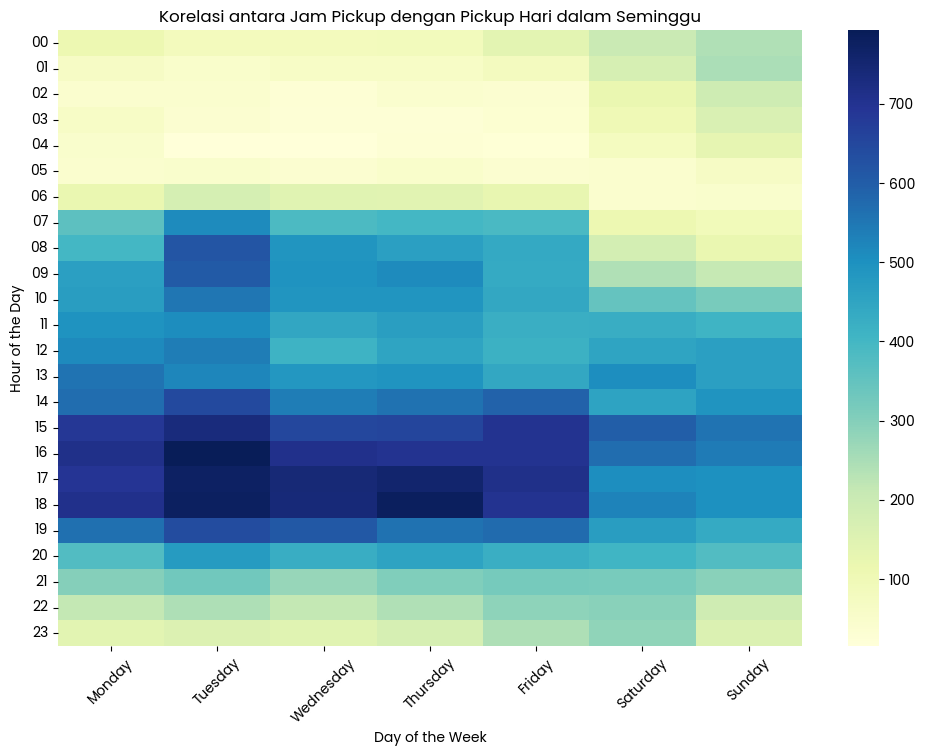

In [59]:
pivot_table = df.pivot_table(index='pickup_hour', columns='day_of_week', aggfunc='size', fill_value=0)

# Mengurutkan hari dalam urutan yang benar
ordered_days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
pivot_table = pivot_table[ordered_days]

# Visualisasi dengan heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(pivot_table, cmap='YlGnBu', fmt="d", cbar=True)

# Menambahkan label, grid, dan judul
plt.title('Korelasi antara Jam Pickup dengan Pickup Hari dalam Seminggu')
plt.xlabel('Day of the Week')
plt.ylabel('Hour of the Day')
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.show()

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>

Berdasarkan grafik heatmap di atas yang menunjukkan korelasi antara jam penjemputan dan hari dalam seminggu, terdapat beberapa pola yang dapat diidentifikasi:

1. **Aktivitas Penjemputan pada Weekday:**
   - Penjemputan terbanyak terjadi pada jam sibuk sore hari, sekitar pukul 17:00 hingga 19:00, terutama pada hari Senin hingga Jumat. Ini menunjukkan bahwa jam-jam tersebut merupakan waktu sibuk dengan banyak perjalanan pulang kerja.
   - Pagi hari antara pukul 07:00 hingga 09:00 juga menunjukkan lonjakan aktivitas penjemputan yang stabil pada weekday, menandakan perjalanan rutin menuju tempat kerja atau sekolah.

2. **Aktivitas Penjemputan pada Weekend:**
   - Pada akhir pekan, pola penjemputan lebih tersebar sepanjang hari. Aktivitas cenderung lebih rendah di pagi hari dan meningkat pada siang hingga sore hari.
   - Tidak ada lonjakan yang spesifik seperti pada weekend, menunjukkan bahwa aktivitas di akhir pekan lebih santai dan bervariasi dibandingkan hari kerja.

3. **Penurunan Aktivitas pada Malam Hari:**
   - Terlihat bahwa setelah pukul 20:00, aktivitas penjemputan cenderung menurun secara signifikan pada semua hari dalam seminggu. Ini menandakan bahwa malam hari umumnya lebih sepi, dengan jumlah perjalanan yang lebih sedikit.

Hasil visualisasi memperlihatkan bahwa aktivitas penjemputan pada hari kerja (weekday) didominasi oleh dua puncak utama: pagi dan sore hari, yang berkaitan dengan rutinitas kerja dan sekolah. Sementara itu, pada akhir pekan (weekend), aktivitas lebih merata dan cenderung terjadi sepanjang hari tanpa pola yang terlalu spesifik.

Jika digabungkan dengan analisis sebelumnya mengenai rata-rata jarak perjalanan, dan total pendapatan dapat disimpulkan bahwa:

- **Rata-rata Jarak Perjalanan (Trip Distance):** Pada weekday, jarak perjalanan tertinggi terjadi pada dini hari, dengan penurunan pada pagi hari yang mencerminkan perjalanan singkat menuju tempat kerja atau sekolah. Pada weekend, jarak perjalanan cenderung lebih stabil dengan lonjakan jarak yang lebih panjang pada dini hari, menandakan aktivitas sosial atau rekreasi.

- **Total Pendapatan (Total Amount):** Pada weekday, total pendapatan tertinggi juga terjadi pada dini hari, meskipun jumlah perjalanan rendah, kemungkinan besar karena jarak yang lebih jauh. Pada weekend, pendapatan bisa tetap tinggi sepanjang hari, terutama pada dini hari dan malam.

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
## 5. 3 Proporsi Trip tiap Borough

In [60]:
busiest_borough = df['PU_Borough'].value_counts().reset_index().rename(columns={'index': 'PU_Borough', 'PU_Borough': 'Borough'})
busiest_borough['Percentage'] = (busiest_borough['count'] / busiest_borough['count'].sum() * 100).round(2).astype(str) + ' %'
busiest_borough

,Borough,count,Percentage
0,Manhattan,36343,61.01 %
1,Queens,15599,26.19 %
2,Brooklyn,7082,11.89 %
3,Bronx,538,0.9 %
4,Staten Island,8,0.01 %


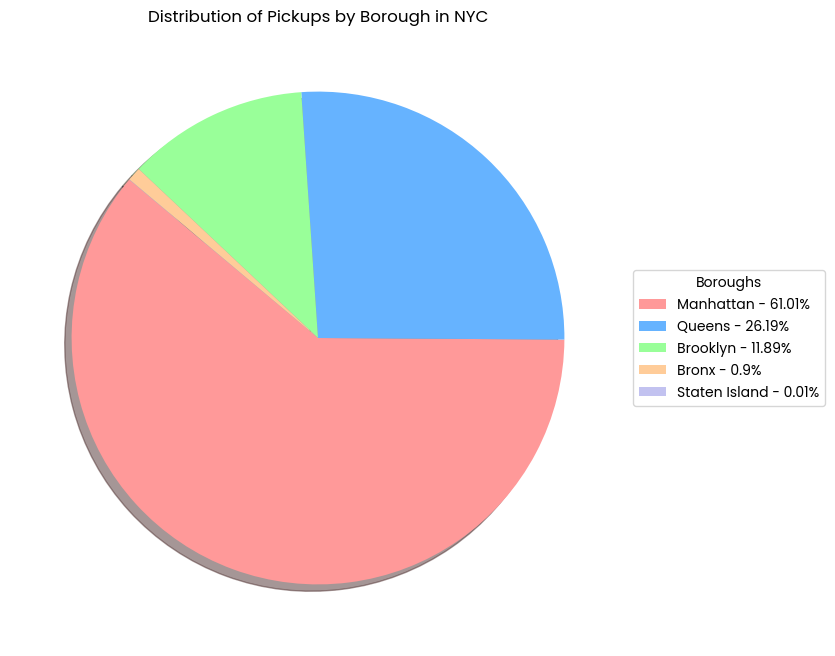

In [61]:
import matplotlib.pyplot as plt

# Mengatur ukuran figure
plt.figure(figsize=(8, 8))
wedges, _ = plt.pie(
    busiest_borough['count'], 
    colors=['#ff9999','#66b3ff','#99ff99','#ffcc99','#c2c2f0'], 
    shadow=True, 
    startangle=140
)

labels = busiest_borough['Borough'] + ' - ' + (busiest_borough['count'] / busiest_borough['count'].sum() * 100).round(2).astype(str) + '%'
plt.legend(wedges, labels, title="Boroughs", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))

plt.title('Distribution of Pickups by Borough in NYC')
plt.show()


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Berdasarkan pie chart distribusi penjemputan di New York City, terlihat bahwa wilayah Manhattan mendominasi aktivitas penjemputan dengan 61% dari total penjemputan. Wilayah ini jelas menjadi pusat utama untuk taksi, diikuti oleh Queens dengan 26,2% dan Brooklyn dengan 11,9%.

Bronx dan Staten Island memiliki kontribusi yang sangat kecil dengan masing-masing hanya 0,9% dan 0,01%. Hal ini menunjukkan bahwa aktivitas penjemputan di kedua wilayah tersebut sangat rendah dibandingkan dengan wilayah lain di NYC. Distribusi ini mencerminkan karakteristik wilayah Manhattan yang memiliki kepadatan tinggi dan aktivitas komersial yang intensif, menjadikannya titik fokus untuk transportasi taksi di kota tersebut.

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
## 5. 4 Jam jam Sibuk Pada Setiap Borough

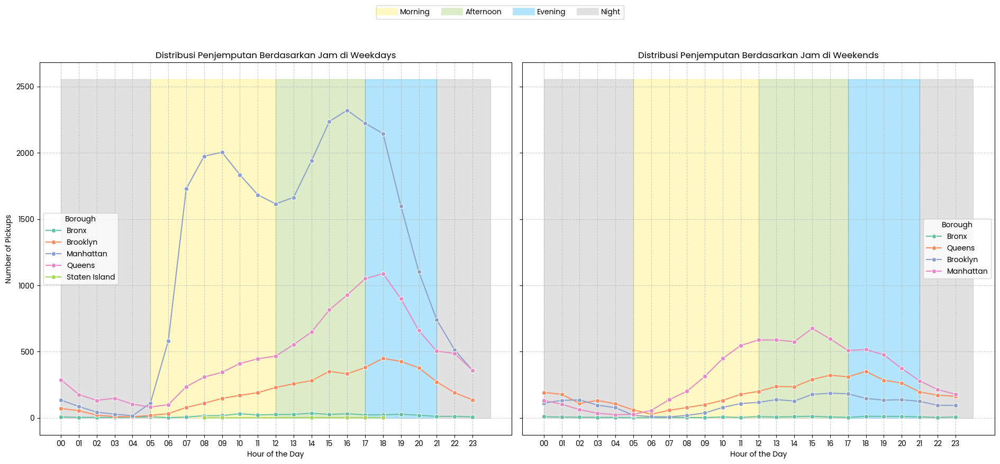

In [62]:
from matplotlib.lines import Line2D

# Mengelompokkan data berdasarkan Borough, pickup_hour, dan day_type
borough_hourly_daytype = df.groupby(['PU_Borough', 'pickup_hour', 'day_type'])['lpep_pickup_datetime'].count().reset_index()
borough_hourly_daytype = borough_hourly_daytype.rename(columns={'lpep_pickup_datetime': 'pickup_count', 'PU_Borough': 'Borough'})

# Membuat plot untuk Weekday dan Weekend
fig, axes = plt.subplots(1, 2, figsize=(19, 8), sharey=True)

# Plot untuk Weekday
weekday_data = borough_hourly_daytype[borough_hourly_daytype['day_type'] == 'Weekday']
sns.lineplot(data=weekday_data, x='pickup_hour', y='pickup_count', hue='Borough', marker='o', palette='Set2', ax=axes[0])
axes[0].fill_between(x=[5, 12], y1=0, y2=weekday_data['pickup_count'].max() * 1.1, color='#FFEB3B', alpha=0.3, label='Morning')
axes[0].fill_between(x=[12, 17], y1=0, y2=weekday_data['pickup_count'].max() * 1.1, color='#8BC34A', alpha=0.3, label='Afternoon')
axes[0].fill_between(x=[17, 21], y1=0, y2=weekday_data['pickup_count'].max() * 1.1, color='#03A9F4', alpha=0.3, label='Evening')
axes[0].fill_between(x=[21, 24], y1=0, y2=weekday_data['pickup_count'].max() * 1.1, color='#9E9E9E', alpha=0.3, label='Night')
axes[0].fill_between(x=[0, 5], y1=0, y2=weekday_data['pickup_count'].max() * 1.1, color='#9E9E9E', alpha=0.3)  
axes[0].set_title('Distribusi Penjemputan Berdasarkan Jam di Weekdays')
axes[0].set_xlabel('Hour of the Day')
axes[0].set_ylabel('Number of Pickups')
axes[0].set_xticks(range(0, 24))
axes[0].grid(True, linestyle='--', alpha=0.6)

# Plot untuk Weekend
weekend_data = borough_hourly_daytype[borough_hourly_daytype['day_type'] == 'Weekend'].sort_values(by='pickup_hour')
sns.lineplot(data=weekend_data, x='pickup_hour', y='pickup_count', hue='Borough', marker='o', palette='Set2', ax=axes[1])
axes[1].fill_between(x=[5, 12], y1=0, y2=weekday_data['pickup_count'].max() * 1.1, color='#FFEB3B', alpha=0.3, label='Morning')
axes[1].fill_between(x=[12, 17], y1=0, y2=weekday_data['pickup_count'].max() * 1.1, color='#8BC34A', alpha=0.3, label='Afternoon')
axes[1].fill_between(x=[17, 21], y1=0, y2=weekday_data['pickup_count'].max() * 1.1, color='#03A9F4', alpha=0.3, label='Evening')
axes[1].fill_between(x=[21, 24], y1=0, y2=weekday_data['pickup_count'].max() * 1.1, color='#9E9E9E', alpha=0.3, label='Night')
axes[1].fill_between(x=[0, 5], y1=0, y2=weekday_data['pickup_count'].max() * 1.1, color='#9E9E9E', alpha=0.3)  
axes[1].set_title('Distribusi Penjemputan Berdasarkan Jam di Weekends')
axes[1].set_xlabel('Hour of the Day')
axes[1].set_xticks(range(0, 24))
axes[1].grid(True, linestyle='--', alpha=0.6)

time_labels = [
    Line2D([0], [0], color='#FFEB3B', lw=10, alpha=0.3, label='Morning'),
    Line2D([0], [0], color='#8BC34A', lw=10, alpha=0.3, label='Afternoon'),
    Line2D([0], [0], color='#03A9F4', lw=10, alpha=0.3, label='Evening'),
    Line2D([0], [0], color='#9E9E9E', lw=10, alpha=0.3, label='Night')
]

# Menyusun legend secara gabungan
handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles= time_labels, loc='upper center', ncol=4, bbox_to_anchor=(0.5, 1.1))

plt.tight_layout()
plt.show()

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Berdasarkan analisis yang lebih mendetail mengenai pola penjemputan di masing-masing borough, berikut adalah penjabaran pola yang terlihat untuk weekdays dan weekends:

**Weekdays:**
1. **Manhattan:** Penjemputan tinggi pada pagi (07:00 - 09:00) dan sore (17:00 - 19:00). Aktivitas menurun drastis setelah jam 21:00.
2. **Queens:** Aktivitas stabil sepanjang hari, dengan puncak pada siang (12:00 - 14:00) dan sore (16:00 - 18:00).
3. **Brooklyn:** Pola mirip Queens, namun dengan volume lebih rendah. Lonjakan pada sore hari.
4. **Bronx:** Aktivitas rendah dan merata sepanjang hari tanpa lonjakan signifikan.
5. **Staten Island:** Aktivitas minimal dengan pergerakan terbatas sepanjang hari.

**Weekends:**
1. **Manhattan:** Penjemputan merata dari pagi hingga malam, dengan puncak pada siang (12:00 - 14:00).
2. **Queens:** Aktivitas meningkat pada siang hingga sore, menurun bertahap hingga malam.
3. **Brooklyn:** Penjemputan stabil dengan puncak di siang (12:00 - 16:00), lalu menurun pada malam hari.
4. **Bronx:** Pola serupa weekdays, aktivitas rendah dan merata sepanjang hari.
5. **Staten Island:** Tidak terdapat aktivitas sama sekali.

Secara keseluruhan, Manhattan tetap menjadi pusat penjemputan baik pada weekdays maupun weekends, dengan Queens dan Brooklyn juga memiliki kontribusi yang signifikan, terutama pada waktu-waktu tertentu. Bronx dan Staten Island, di sisi lain, memiliki aktivitas penjemputan yang rendah sepanjang minggu tanpa perbedaan yang mencolok antara weekdays dan weekends.

Selanjutnya akan dilakukan analisa lebih mendalam dengan menganalisa tiap Zona zona yang tergolong ramai

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
## 5. 5 Analisa Zona

In [63]:
# Menghitung zone tersibuk berdasarkan pickup
busiest_zone = df['PU_Zone'].value_counts().reset_index().rename(columns={'index': 'Zone', 'PU_Zone': 'Zone', 'count': 'Count'})

# kolom borough
busiest_zone = busiest_zone.merge(borough_zone, left_on='Zone', right_on='Zone', how='inner')
busiest_zone = busiest_zone.drop(columns=['LocationID', 'service_zone'])

busiest_zone.head(15)

,Zone,Count,Borough
0,East Harlem North,12586,Manhattan
1,East Harlem South,8610,Manhattan
2,Forest Hills,3630,Queens
3,Central Harlem,3610,Manhattan
4,Morningside Heights,3544,Manhattan
5,Central Park,2813,Manhattan
6,Elmhurst,2753,Queens
7,Fort Greene,2062,Brooklyn
8,Astoria,1618,Queens
9,Washington Heights South,1580,Manhattan


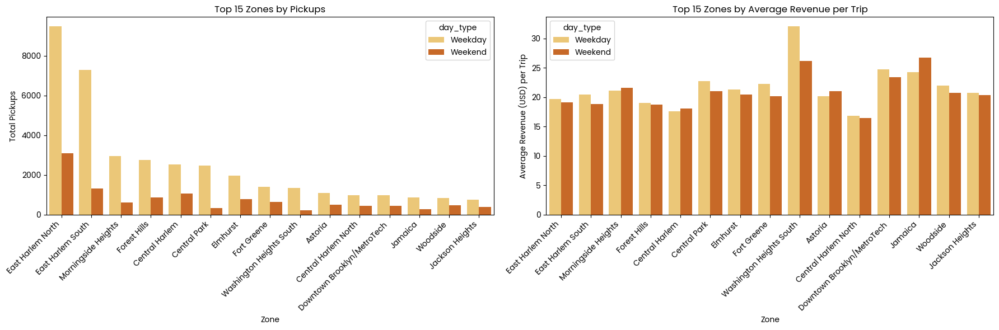

In [64]:
# Menghitung rata-rata pickup dan total pendapatan berdasarkan zone dan day_type
zone_pickups = df.groupby(['PU_Zone', 'day_type'])['lpep_pickup_datetime'].count().reset_index()
zone_pickups = zone_pickups.rename(columns={'lpep_pickup_datetime': 'Pickups'})
zone_pickups = zone_pickups.sort_values(by='Pickups', ascending=False)

zone_avg_revenue = df.groupby(['PU_Zone', 'day_type'])['total_amount'].mean().reset_index()
zone_avg_revenue = zone_avg_revenue.rename(columns={'total_amount': 'Avg_Revenue'})
zone_avg_revenue = zone_avg_revenue.sort_values(by='Avg_Revenue', ascending=False)

# Menggabungkan data berdasarkan Zone dan day_type
combined_data = zone_pickups.merge(zone_avg_revenue, on=['PU_Zone', 'day_type'])

# Memilih 15 zona tersibuk untuk weekday dan weekend
top_zones_weekday = combined_data[combined_data['day_type'] == 'Weekday'].nlargest(15, 'Pickups')
top_zones_weekend = combined_data[combined_data['day_type'] == 'Weekend'].nlargest(15, 'Pickups')

# Menyiapkan plot
fig, axes = plt.subplots(1, 2, figsize=(18, 6), sharey=False)

# Plot untuk rata-rata pickup dengan hue berdasarkan day_type
sns.barplot(ax=axes[0], x='PU_Zone', y='Pickups', hue='day_type', data=combined_data[combined_data['PU_Zone'].isin(top_zones_weekday['PU_Zone'])], palette='YlOrBr')
axes[0].set_title('Top 15 Zones by Pickups')
axes[0].set_xlabel('Zone')
axes[0].set_ylabel('Total Pickups')
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')

# Plot untuk rata-rata pendapatan dengan hue berdasarkan day_type
sns.barplot(ax=axes[1], x='PU_Zone', y='Avg_Revenue', hue='day_type', data=combined_data[combined_data['PU_Zone'].isin(top_zones_weekend['PU_Zone'])], palette='YlOrBr')
axes[1].set_title('Top 15 Zones by Average Revenue per Trip')
axes[1].set_xlabel('Zone')
axes[1].set_ylabel('Average Revenue (USD) per Trip')
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')

plt.tight_layout()
plt.show()

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
1. **Perbedaan Antara Zona dengan Aktivitas Tinggi dan Rata - rata Pendapatan per trip yang Tinggi:**
   - Meskipun "East Harlem North" dan "East Harlem South" menjadi zona dengan aktivitas penjemputan tertinggi, tidak semua perjalanan menghasilkan rata rata pendapatan per trip besar. Misalnya, "East Harlem North" yang memiliki jumlah penjemputan tertinggi juga mendominasi dalam rata rata pendapatan per trip, namun "Forest Hills" yang berada di posisi ketiga dalam jumlah penjemputan tidak menunjukkan posisi yang sama dalam rata rata pendapatan per trip. Ini menekankan bahwa zona dengan banyak penjemputan tidak selalu menghasilkan rata rata pendapatan per trip yang tinggi.
   - Zona seperti "Morningside Heights" dan "Central Harlem" menempati peringkat lebih rendah dalam jumlah penjemputan, tetapi mereka berada di posisi yang lebih tinggi dalam hal rata rata pendapatan per trip. Ini menunjukkan bahwa perjalanan di zona ini mungkin lebih sedikit, namun bernilai lebih tinggi per perjalanan.

2. **Rata - rata Pendapatan per trip Tidak Selalu Berkorelasi dengan Aktivitas yang Tinggi:**
   - "Fort Greene" dan "Central Park" memiliki aktivitas penjemputan yang signifikan tetapi berada di posisi menengah dalam hal pendapatan per trip. Ini mengindikasikan bahwa banyaknya perjalanan di zona-zona ini tidak selalu diikuti oleh pendapatan per trip yang besar, mungkin karena perjalanan lebih pendek atau tarif lebih rendah.
   - "Morningside Heights," di sisi lain, meskipun tidak menempati posisi puncak dalam jumlah penjemputan, memiliki rata rata pendapatan per trip yang lebih tinggi, mengindikasikan bahwa perjalanan dari zona ini mungkin lebih bernilai, entah karena jarak yang lebih jauh atau tarif yang lebih mahal.

3. **Zona dengan Penjemputan dan Pendapatan per trip Terendah:**
   - Zona seperti "Jackson Heights" dan "Jamaica" menunjukkan jumlah penjemputan dan rata rata pendapatan per trip yang lebih rendah secara konsisten, memperlihatkan bahwa aktivitas transportasi di sana lebih sedikit dan kurang bernilai.

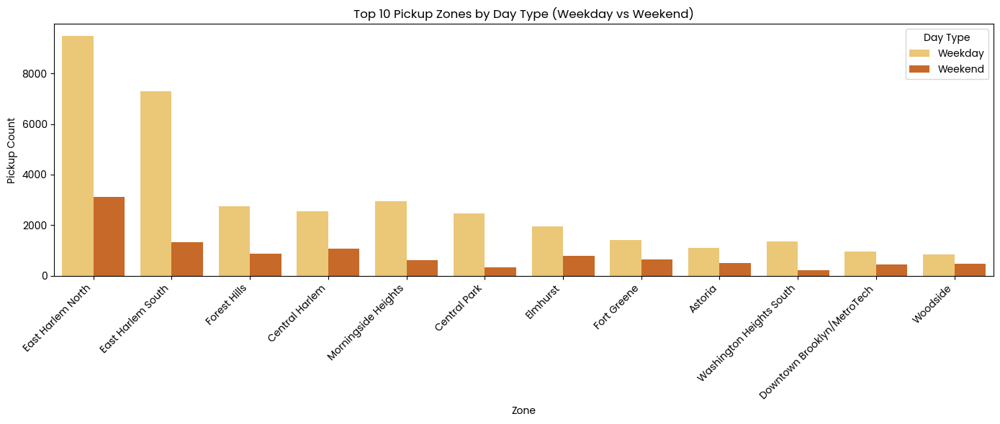

In [65]:

busiest_zone_by_daytype = df.groupby(['PU_Zone', 'day_type'])['lpep_pickup_datetime'].count().reset_index()
busiest_zone_by_daytype.columns = ['Zone', 'day_type', 'Count']

# data weekday dan weekend
weekday_zones = busiest_zone_by_daytype[busiest_zone_by_daytype['day_type'] == 'Weekday'].sort_values(by='Count', ascending=False).head(10)
weekend_zones = busiest_zone_by_daytype[busiest_zone_by_daytype['day_type'] == 'Weekend'].sort_values(by='Count', ascending=False).head(10)

busiest_zones_combined = busiest_zone_by_daytype[busiest_zone_by_daytype['Zone'].isin(
    pd.concat([weekday_zones['Zone'], weekend_zones['Zone']])
)]

zone_order = busiest_zones_combined.groupby('Zone')['Count'].sum().sort_values(ascending=False).index

plt.figure(figsize=(14, 6))
sns.barplot(
    x='Zone', 
    y='Count', 
    hue='day_type', 
    data=busiest_zones_combined,
    order=zone_order,  # Mengurutkan berdasarkan total count
    palette='YlOrBr'
)
plt.title('Top 10 Pickup Zones by Day Type (Weekday vs Weekend)')
plt.xticks(rotation=45, ha='right')
plt.ylabel('Pickup Count')
plt.xlabel('Zone')
plt.legend(title='Day Type')
plt.tight_layout()
plt.show()


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Berdasarkan grafik di atas, terlihat bahwa zona **East Harlem North** dan **East Harlem South** mendominasi penjemputan, baik pada hari kerja (weekday) maupun akhir pekan (weekend). Berikut poin-poin utama yang dapat disimpulkan:

1. **East Harlem North** menjadi zona tersibuk pada weekday dengan jumlah penjemputan yang jauh lebih tinggi dibandingkan zona lainnya. Namun, pada weekend, penjemputan di zona ini menurun signifikan tetapi tetap menjadi yang tertinggi dibandingkan zona lain.

2. **East Harlem South** juga menunjukkan pola yang sama, dengan penjemputan yang cukup tinggi pada weekday dan penurunan pada weekend, meskipun tetap mendominasi.

3. Zona seperti **Forest Hills**, **Central Harlem**, dan **Morningside Heights** menunjukkan aktivitas yang cukup signifikan, terutama pada weekday, tetapi mengalami penurunan yang lebih tajam pada weekend.

4. Pada weekend, zona seperti **Central Park**, **Elmhurst**, dan **Astoria** masih aktif dengan penjemputan yang cukup stabil, meskipun tidak setinggi pada weekday.

5. Zona dengan aktivitas yang relatif stabil baik pada weekday maupun weekend adalah **Fort Greene**, **Downtown Brooklyn/MetroTech**, dan **Woodside**, meskipun jumlah penjemputan tetap lebih rendah dibandingkan zona utama seperti East Harlem.

Secara keseluruhan, pola ini menunjukkan bahwa beberapa zona utama seperti East Harlem tetap menjadi pusat aktivitas taksi di NYC, baik pada hari kerja maupun akhir pekan, sementara beberapa zona lainnya mengalami variasi aktivitas yang lebih tajam antara weekday dan weekend.

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
### 5. 5. 1 Zona zona yang Ramai Tiap Borough

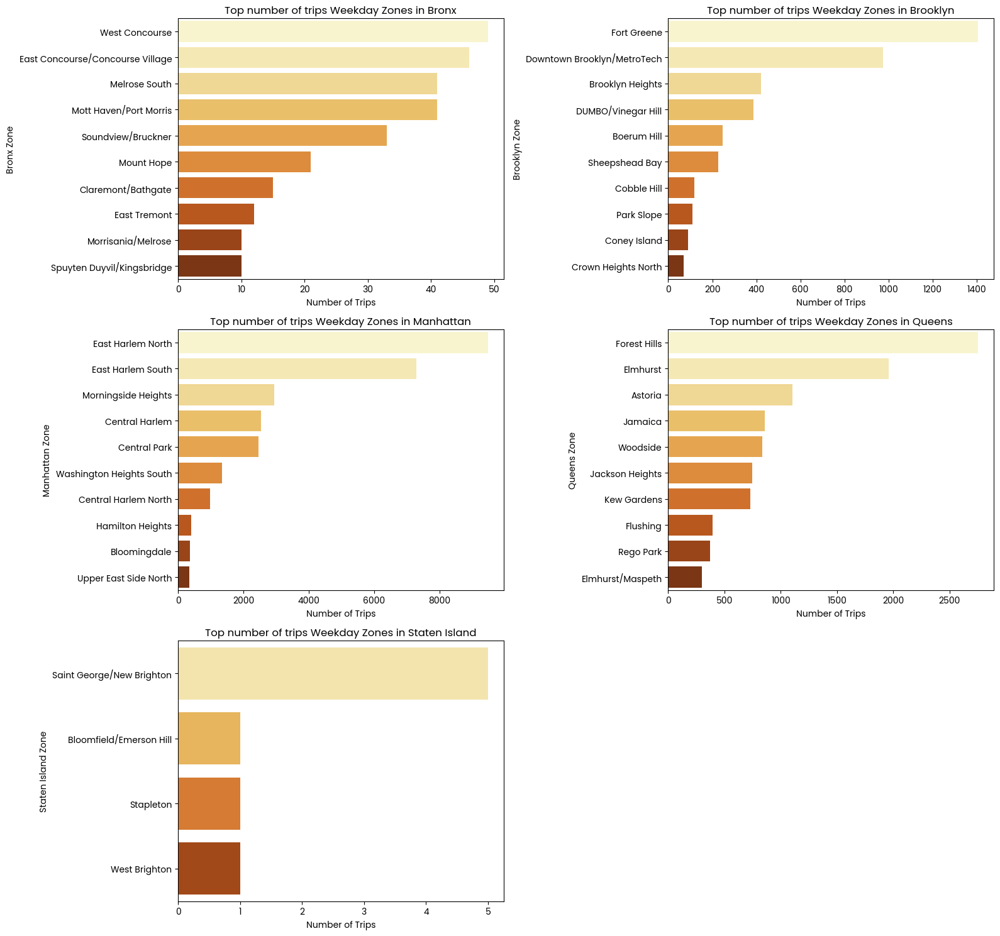

In [66]:
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Mengelompokkan data berdasarkan borough, zone, dan day_type
top_zones_by_borough = df.groupby(['PU_Borough', 'PU_Zone', 'day_type'])['lpep_pickup_datetime'].count().reset_index()
top_zones_by_borough.columns = ['Borough', 'Zone', 'day_type', 'Number of Trips']

# Mengurutkan zona berdasarkan jumlah trips untuk masing-masing borough dan day_type
top_zones_by_borough = top_zones_by_borough.sort_values(by=['Borough', 'Number of Trips'], ascending=[True, False])

# Mendapatkan daftar borough unik
boroughs = top_zones_by_borough['Borough'].unique()

# Plot untuk Weekday
fig, axes = plt.subplots(math.ceil(len(boroughs) / 2), 2, figsize=(16, math.ceil(len(boroughs) / 2) * 5))
axes = axes.flatten()
for i, borough in enumerate(boroughs):
    top_zones_weekday = top_zones_by_borough[(top_zones_by_borough['Borough'] == borough) & (top_zones_by_borough['day_type'] == 'Weekday')].head(10)
    sns.barplot(x='Number of Trips', y='Zone', data=top_zones_weekday, palette='YlOrBr', ax=axes[i])
    axes[i].set_title(f'Top number of trips Weekday Zones in {borough}')
    axes[i].set_xlabel('Number of Trips')
    axes[i].set_ylabel(f'{borough} Zone')
plt.delaxes(axes[-1])
plt.tight_layout()
plt.show()


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Grafik di atas menunjukkan zona dengan jumlah perjalanan tertinggi pada hari kerja (weekday) di masing-masing borough di New York City. Di Bronx, West Concourse mendominasi aktivitas, sedangkan di Brooklyn, Fort Greene menjadi yang tersibuk. Manhattan didominasi oleh zona East Harlem North dan South dengan volume perjalanan yang sangat tinggi. Di Queens, Forest Hills dan Elmhurst memimpin, sementara di Staten Island memiliki aktivitas yang jauh lebih rendah dibandingkan borough lainnya. Secara keseluruhan, Manhattan dan Brooklyn menunjukkan tingkat aktivitas yang paling intensif di antara semua zona per borough.

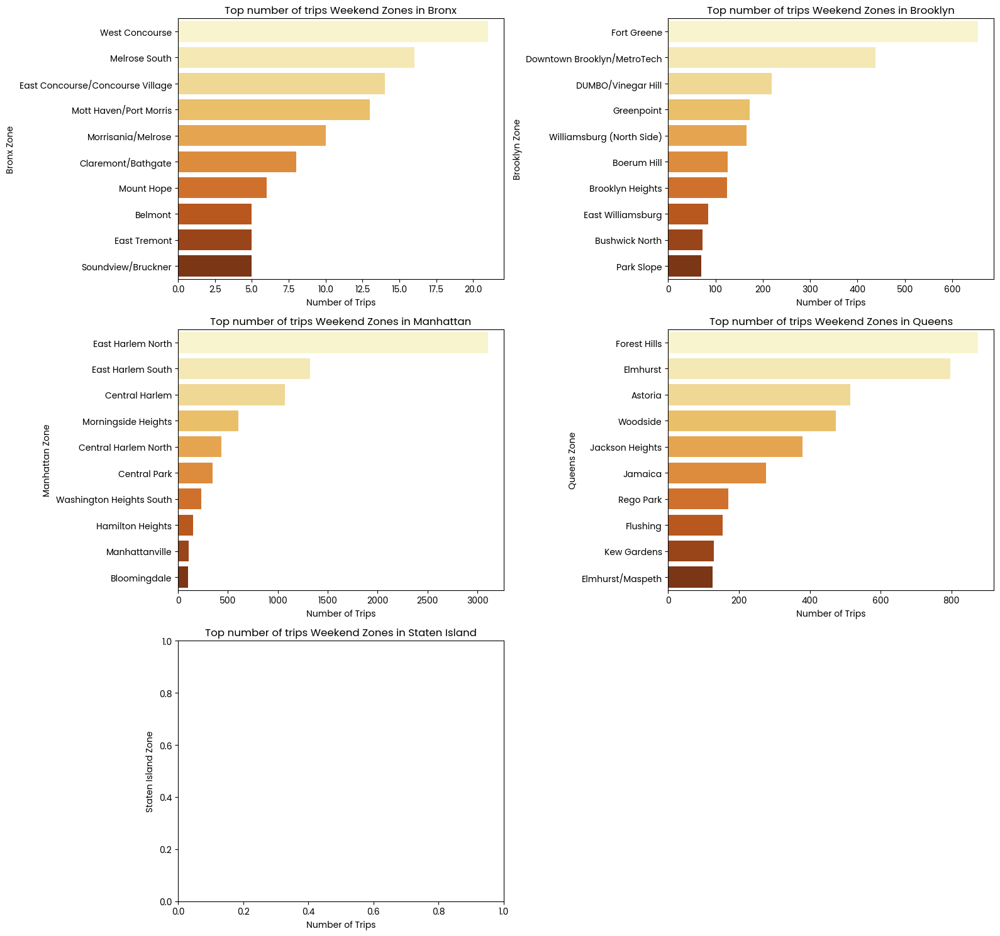

In [67]:
# Plot untuk Weekend
fig, axes = plt.subplots(math.ceil(len(boroughs) / 2), 2, figsize=(16, math.ceil(len(boroughs) / 2) * 5))
axes = axes.flatten()
for i, borough in enumerate(boroughs):
    top_zones_weekend = top_zones_by_borough[(top_zones_by_borough['Borough'] == borough) & (top_zones_by_borough['day_type'] == 'Weekend')].head(10)
    sns.barplot(x='Number of Trips', y='Zone', data=top_zones_weekend, palette='YlOrBr', ax=axes[i])
    axes[i].set_title(f'Top number of trips Weekend Zones in {borough}')
    axes[i].set_xlabel('Number of Trips')
    axes[i].set_ylabel(f'{borough} Zone')
plt.delaxes(axes[-1])
plt.tight_layout()
plt.show()

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Grafik di atas menunjukkan zona dengan jumlah perjalanan tertinggi pada akhir pekan (weekend) di masing-masing borough di New York City. Di Bronx, West Concourse masih mendominasi aktivitas walaupun tergolong rendah, sementara di Brooklyn, Fort Greene tetap menjadi zona tersibuk. Manhattan juga masih didominasi oleh zona East Harlem North dan South, meskipun dengan penurunan volume dibandingkan hari kerja. Di Queens, Forest Hills dan Elmhurst tetap memimpin dengan aktivitas tinggi. Di Staten Island, aktivitas sangat rendah dengan jumlah perjalanan yang nyaris tidak signifikan. Secara umum, pola aktivitas selama akhir pekan cenderung mirip dengan hari kerja, meskipun dengan volume yang sedikit menurun di beberapa borough. Bahkan pada Staten Island sama sekali tidak terdapat aktivitas.

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
### 5. 5. 2 Rata rata Panjang Perjalanan Zona Tiap Borough

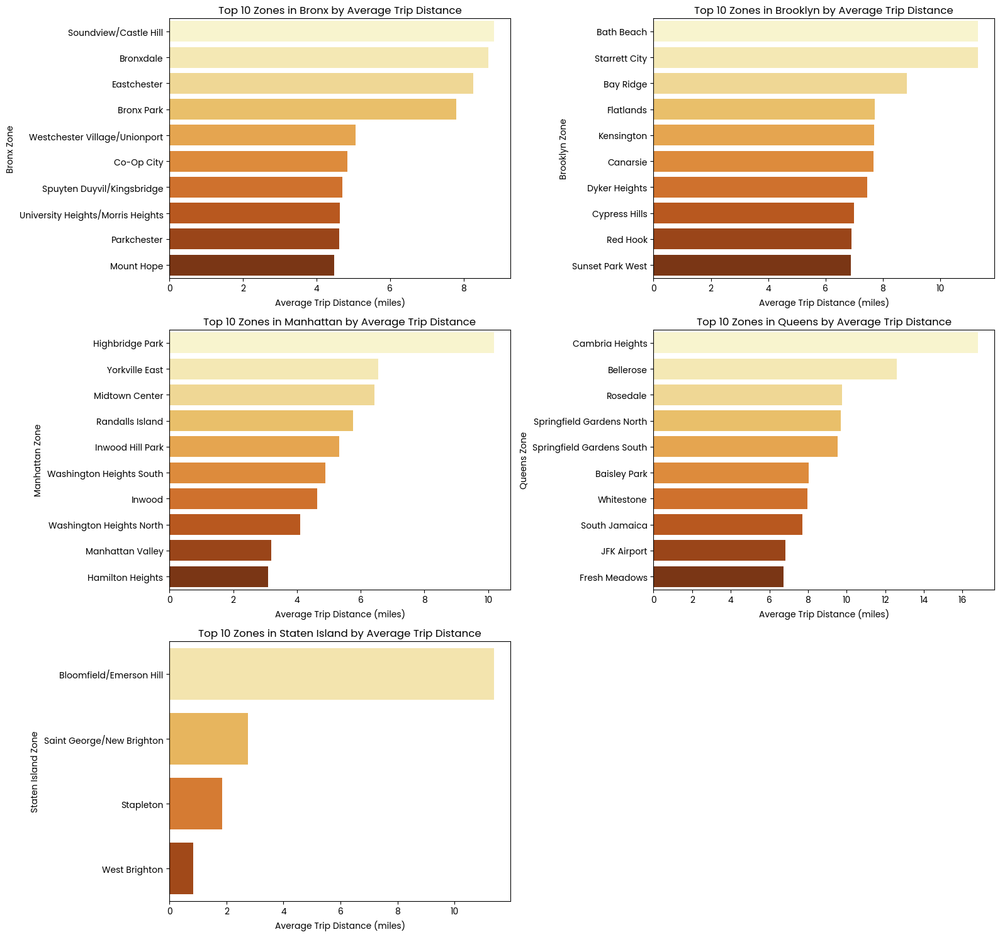

In [68]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Mengelompokkan data berdasarkan borough dan zona serta menghitung rata-rata panjang perjalanan
avg_trip_distance_per_zone = df.groupby(['PU_Borough', 'PU_Zone'])['trip_distance'].mean().reset_index()
avg_trip_distance_per_zone.columns = ['Borough', 'Zone', 'Average Trip Distance']

# Mengurutkan data berdasarkan borough dan rata-rata trip distance
avg_trip_distance_per_zone = avg_trip_distance_per_zone.sort_values(by=['Borough', 'Average Trip Distance'], ascending=[True, False])

# Mengambil 10 zona teratas berdasarkan trip distance di setiap borough
top_zones_by_borough = avg_trip_distance_per_zone.groupby('Borough').head(10).reset_index(drop=True)

# Mendapatkan daftar borough unik
boroughs = top_zones_by_borough['Borough'].unique()

# Menghitung jumlah subplot yang dibutuhkan berdasarkan jumlah borough
num_rows = math.ceil(len(boroughs) / 2)  # Mengatur 2 plot per baris

fig, axes = plt.subplots(num_rows, 2, figsize=(16, num_rows * 5))
axes = axes.flatten()

# Plot untuk setiap borough
for i, borough in enumerate(boroughs):
    top_zones = top_zones_by_borough[top_zones_by_borough['Borough'] == borough]
    sns.barplot(x='Average Trip Distance', y='Zone', data=top_zones, palette='YlOrBr', ax=axes[i])
    axes[i].set_title(f'Top 10 Zones in {borough} by Average Trip Distance')
    axes[i].set_xlabel('Average Trip Distance (miles)')
    axes[i].set_ylabel(f'{borough} Zone')

# Menghilangkan subplot yang kosong jika jumlah borough kurang dari subplot yang disediakan
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Grafik di atas menunjukkan rata-rata jarak perjalanan (trip distance) untuk 10 zona teratas di setiap borough di New York City. Berikut adalah beberapa pola yang dapat diidentifikasi:

- **Bronx**: Zona seperti Soundview/Castle Hill, Bronxdale, dan Eastchester menampilkan rata-rata jarak perjalanan yang lebih tinggi dibandingkan dengan zona lainnya. Meskipun rata-rata jarak perjalanan relatif panjang jumlah perjalanan di Bronx sendiri tergolong sedikit.

- **Brooklyn**: Zona seperti Bath Beach dan Starrett City menunjukkan rata-rata jarak perjalanan yang cukup tinggi. Namun, zona seperti Cypress Hills dan Red Hook memiliki jarak perjalanan yang lebih panjang, yang bisa menjadi indikasi bahwa perjalanan di zona tersebut lebih jarang tetapi mencakup jarak yang lebih jauh.

- **Manhattan**: Meskipun Manhattan umumnya memiliki zona dengan perjalanan yang lebih pendek, zona seperti Highbridge Park dan Yorkville East menampilkan rata-rata jarak yang lebih tinggi. Ini menunjukkan adanya perjalanan yang mencakup wilayah lebih luas, meskipun masih dalam batasan kota.

- **Queens**: Zona seperti Cambria Heights, Bellerose, dan Rosedale memiliki rata-rata jarak perjalanan yang tinggi, terutama zona yang terlibat dalam perjalanan jarak jauh karena menjadi pusat transportasi.

- **Staten Island**: Zona seperti Bloomfield/Emerson Hill dan Saint George/New Brighton menunjukkan jarak perjalanan yang lebih panjang dibandingkan zona lain di Staten Island. Namun jumlah perjalanan pada Staten Island tergolong sangat sedikit.

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
## 5. 6 Melihat Banyak Trip/Pickup Pada Setiap Zona dan Borough Menggunakan Map Folium

In [69]:
import folium
import geopandas as gpd
import pandas as pd

# load nyc taxi geojson
nyc_geojson = gpd.read_file('NYC_Taxi_Zones.geojson')

nyc_geojson['borough'].value_counts().reset_index()

,borough,count
0,Queens,69
1,Manhattan,69
2,Brooklyn,61
3,Bronx,43
4,Staten Island,20
5,EWR,1


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
### 5. 6. 1 Total Pickup Pada Tiap Borough

In [70]:
# Drop data dengan kolom borough EWR
nyc_geojson = nyc_geojson[nyc_geojson['borough'] != 'EWR']

# Menghitung total pickup per borough
borough_pickup = df.groupby('PU_Borough')['lpep_pickup_datetime'].count().reset_index()
borough_pickup.columns = ['Borough', 'Total_Pickup']

# Merge with GeoJSON data
nyc_geojson = nyc_geojson.merge(borough_pickup, left_on='borough', right_on='Borough', how='left')


# Create map
nyc_map = folium.Map(location=[40.7128, -74.0060], zoom_start=10)

choropleth = folium.Choropleth(
    geo_data=nyc_geojson,
    data=nyc_geojson,
    columns=['borough', 'Total_Pickup'],
    key_on='feature.properties.borough',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total Pickups per Borough',
    bins=[0, 5000, 10000, 20000, 30000, 40000],
    reset=True
).add_to(nyc_map)

# Tooltip
tooltip = folium.GeoJsonTooltip(
    fields=['borough', 'Total_Pickup'], 
    aliases=['Borough:', 'Total Pickups:'],
    localize=True
)

# Layer
folium.GeoJson(
    nyc_geojson,
    name='geojson',
    tooltip=tooltip,
    style_function=lambda x: {'color': 'black', 'weight': 0.5}
).add_to(choropleth)

locations = {
    'Statue of Liberty': [40.6892, -74.0445],
    'Empire State Building': [40.748817, -73.985428],
    'Central Park': [40.785091, -73.968285],
    'Columbia University': [40.8075, -73.9626],
    'Marcus Garvey Park': [40.8055, -73.9448],
    'NYC Health + Hospitals/Elmhurst': [40.7423, -73.8782],
    'Forest Hills Stadium': [40.7181, -73.8448],
    'Brooklyn Bridge': [40.706086, -73.996864],
    'Barclays Center': [40.6827, -73.9754],
    'Times Square': [40.7580, -73.9855],
    'Grand Central Terminal': [40.7527, -73.9772],
    'Penn Station': [40.7506, -73.9935],
    'Union Square': [40.7359, -73.9911],
    'Chinatown': [40.7158, -73.9970],
    'Battery Park': [40.7033, -74.0170],
    'Flushing Meadows Corona Park': [40.7498, -73.8407],
    'LaGuardia Airport': [40.7769, -73.8740],
    'JFK Airport': [40.6413, -73.7781],
    'Wall Street': [40.7074, -74.0113],
    'Yankee Stadium': [40.8296, -73.9262],
    'Bronx Zoo': [40.8506, -73.8762],
    'New York Botanical Garden': [40.8623, -73.8800],
    'Fordham University': [40.8616, -73.8853],
    'Little Italy (Arthur Avenue)': [40.8553, -73.8871],
    'Citi Field': [40.7571, -73.8458],
    'Queens Museum': [40.7450, -73.8465],
    'Gantry Plaza State Park': [40.7464, -73.9560],
    'The Unisphere': [40.7459, -73.8448],
    'Prospect Park': [40.6602, -73.9690],
    'Brooklyn Botanic Garden': [40.6694, -73.9624],
    'Coney Island Boardwalk': [40.5743, -73.9876],
    'DUMBO': [40.7033, -73.9882],
    'Staten Island Ferry Terminal': [40.6437, -74.0737],
    'Snug Harbor Cultural Center & Botanical Garden': [40.6431, -74.1010],
    'Historic Richmond Town': [40.5707, -74.1453],
    'Staten Island Zoo': [40.6257, -74.1163]
}

# Add markers to the map
for location, coordinates in locations.items():
    folium.Marker(
        location=coordinates,
        tooltip=location,
        icon=folium.Icon(color='red', icon='info-sign')
    ).add_to(nyc_map)


# Add legend
folium.LayerControl().add_to(nyc_map)

# Display the map
nyc_map

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
### 5. 6. 2 Total pickup pada tiap zone

In [71]:
# Drop data dengan kolom borough EWR
nyc_geojson = nyc_geojson[nyc_geojson['borough'] != 'EWR']

# Menghitung total pickup per zone
zone_pickup = df.groupby('PU_Zone')['lpep_pickup_datetime'].count().reset_index()
zone_pickup.columns = ['Zone', 'Total_Pickup']

# Merge dengan GeoJSON data
nyc_geojson = nyc_geojson.drop(columns=['Total_Pickup'], errors='ignore') 
nyc_geojson = nyc_geojson.drop(columns=['Zone'] , errors='ignore')

nyc_geojson = nyc_geojson.merge(zone_pickup, left_on='zone', right_on='Zone', how='left')

# Fill missing pickup values with 0
nyc_geojson['Total_Pickup'].fillna(0, inplace=True)

# Create map
nyc_map = folium.Map(location=[40.7128, -74.0060], zoom_start=10)

# Choropleth
choropleth = folium.Choropleth(
    geo_data=nyc_geojson,
    data=nyc_geojson,
    columns=['zone', 'Total_Pickup'],
    key_on='feature.properties.zone',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total Pickups per Zone',
    bins=[0, 1000, 5000, 10000, 15000, 20000, 25000],
    reset=True
).add_to(nyc_map)

# Tooltip
tooltip = folium.GeoJsonTooltip(
    fields=['zone', 'Total_Pickup'], 
    aliases=['Zone:', 'Total Pickups:'],
    localize=True
)

# Layer tooltip
folium.GeoJson(
    nyc_geojson,
    name='geojson',
    tooltip=tooltip,
    style_function=lambda x: {'color': 'black', 'weight': 0.5}
).add_to(choropleth)

locations = {
    'Statue of Liberty': [40.6892, -74.0445],
    'Empire State Building': [40.748817, -73.985428],
    'Central Park': [40.785091, -73.968285],
    'Columbia University': [40.8075, -73.9626],
    'Marcus Garvey Park': [40.8055, -73.9448],
    'NYC Health + Hospitals/Elmhurst': [40.7423, -73.8782],
    'Forest Hills Stadium': [40.7181, -73.8448],
    'Brooklyn Bridge': [40.706086, -73.996864],
    'Barclays Center': [40.6827, -73.9754],
    'Times Square': [40.7580, -73.9855],
    'Grand Central Terminal': [40.7527, -73.9772],
    'Penn Station': [40.7506, -73.9935],
    'Union Square': [40.7359, -73.9911],
    'Chinatown': [40.7158, -73.9970],
    'Battery Park': [40.7033, -74.0170],
    'Flushing Meadows Corona Park': [40.7498, -73.8407],
    'LaGuardia Airport': [40.7769, -73.8740],
    'JFK Airport': [40.6413, -73.7781],
    'Wall Street': [40.7074, -74.0113],
    'Yankee Stadium': [40.8296, -73.9262],
    'Bronx Zoo': [40.8506, -73.8762],
    'New York Botanical Garden': [40.8623, -73.8800],
    'Fordham University': [40.8616, -73.8853],
    'Little Italy (Arthur Avenue)': [40.8553, -73.8871],
    'Citi Field': [40.7571, -73.8458],
    'Queens Museum': [40.7450, -73.8465],
    'Gantry Plaza State Park': [40.7464, -73.9560],
    'The Unisphere': [40.7459, -73.8448],
    'Prospect Park': [40.6602, -73.9690],
    'Brooklyn Botanic Garden': [40.6694, -73.9624],
    'Coney Island Boardwalk': [40.5743, -73.9876],
    'DUMBO': [40.7033, -73.9882],
    'Staten Island Ferry Terminal': [40.6437, -74.0737],
    'Snug Harbor Cultural Center & Botanical Garden': [40.6431, -74.1010],
    'Historic Richmond Town': [40.5707, -74.1453],
    'Staten Island Zoo': [40.6257, -74.1163]
}
# Marker
for location, coordinates in locations.items():
    folium.Marker(
        location=coordinates,
        tooltip=location,
        icon=folium.Icon(color='red', icon='info-sign')
    ).add_to(nyc_map)
# Add legend
folium.LayerControl().add_to(nyc_map)

# Display the map
nyc_map


<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
Area-area ramai di New York City ini umumnya berada dekat dengan pusat aktivitas ekonomi, wisata, dan pendidikan yang signifikan. Di **Manhattan**, kawasan seperti **Times Square**, **Wall Street**, dan **Grand Central Terminal** sangat ramai karena menjadi pusat bisnis dan transportasi utama. Selain itu, tempat wisata seperti **Central Park** dan **Empire State Building**. **Brooklyn** terkenal dengan spot seperti **Brooklyn Bridge** dan **Barclays Center**, yang merupakan pusat budaya dan penghubung utama antar borough. **Queens** memiliki lokasi penting seperti **LaGuardia Airport** dan **Flushing Meadows Corona Park** yang menjadi titik aktivitas lokal dan internasional. Di **Bronx**, **Yankee Stadium** dan **Bronx Zoo** menjadi pusat keramaian karena acara olahraga dan rekreasi. **Staten Island** ramai di sekitar **Staten Island Ferry Terminal** dan destinasi budaya seperti **Snug Harbor Cultural Center**.

**Alasan Keramaian:**
- Dekat dengan pusat bisnis dan komersial.
- Menjadi destinasi wisata utama.
- Berperan sebagai titik penghubung transportasi.

<style>
@import url('https://fonts.googleapis.com/css2?family=Poppins:wght@300;400;500;600;700&display=swap');

body, 
div, 
h1, 
h2, 
h3, 
h4, 
h5, 
h6, 
p, 
span, 
label, 
input, 
textarea, 
button, 
pre, 
code, 
kbd, 
samp {
    font-family: 'Poppins', sans-serif !important;
}
</style>
### Kesimpulan Analisis

1. **Weekday vs. Weekend:**
   - **Jam Puncak Penjemputan:** Pada **weekday**, penjemputan tertinggi terjadi pada pagi hari (07:00 - 09:00) dan sore hari (17:00 - 19:00), terutama di **Manhattan** pada zona **East Harlem North** dan **East Harlem South**. 
   - **Distribusi Pendapatan:** Meskipun volume penjemputan lebih tinggi pada weekday, **pendapatan rata-rata per trip cenderung serupa** antara weekday dan weekend, dengan rata rata pendapatan per trip tertinggi terjadi pada dini hari sekitar pukul 04:00. Akan tetapi **pendapatan perhari bisa jauh berbeda** dikarenakan frekuensi dari trip yang tinggi pada daerah yang ramai.

2. **Wilayah Tersibuk:**
   - **Manhattan** tetap menjadi pusat aktivitas penjemputan baik pada weekday maupun weekend, dengan zona seperti **Central Harlem** dan **Times Square** juga menunjukkan tingkat aktivitas tinggi.
   - **Queens** dan **Brooklyn** memiliki penjemputan signifikan pada siang hari selama weekend, namun masih di bawah Manhattan.
   - **Bronx** dan **Staten Island** menunjukkan **jarak perjalanan lebih panjang** namun dengan volume penjemputan yang rendah.

### Rekomendasi

1. **Penempatan Armada yang Tepat:**
   - **Weekday:** Fokuskan armada di **Manhattan** pada **jam sibuk pagi (07:00 - 09:00) dan sore (17:00 - 19:00)**. Hindari **oversupply** di area ini untuk menjaga **pendapatan per driver**.
   - **Weekend:** Tempatkan armada di **Queens** (**Forest Hills**, **Elmhurst**) dan **Brooklyn** (**Fort Greene**, **Downtown Brooklyn/MetroTech**) pada **siang hari (12:00 - 15:00)** untuk memanfaatkan permintaan yang stabil. Driver yang lebih suka persaingan rendah dapat fokus di zona ini.

2. **Penyesuaian Jam Operasional:**
   - Mulai operasional lebih awal, sekitar **pukul 04:00**, untuk **memaksimalkan pendapatan per trip** di zona seperti **Central Park** dan **East Harlem**.

3. **Optimalisasi Rute:**
   - **Bronx** dan **Staten Island**: Driver di zona ini bisa fokus pada **perjalanan jarak jauh** yang lebih bernilai, meskipun frekuensinya rendah, untuk menghindari persaingan di zona-zona padat.

4. **Kampanye di Zona dengan Aktivitas Rendah:**
   - **Staten Island** dan zona lainnya dengan aktivitas rendah dapat ditingkatkan melalui **kampanye promosi atau diskon** untuk menarik lebih banyak penumpang dan menghindari oversupply di zona utama.

Rekomendasi ini dirancang untuk memberikan **fleksibilitas** kepada driver dalam memilih strategi operasi yang sesuai dengan preferensi mereka, serta membantu **menghindari risiko oversupply** yang dapat mengurangi pendapatan.